In [1]:
# Homework 5 (due 07/30/2024)

# SVM and Kernels

### Objective
Through this project, you will learn to use nonlinear kernels to improve a support vector classifier. The toy examples within this project aim to guide you as you build your intuition for the decision boundaries that can be generated via different kernels.

This project is structured as follows:
#### Part 1: Binary classification of synthetic data
1.1. Generate and explore synthetic data

1.2. SVM with nonlinear kernels
#### Part 2: US Flags
2.1. Load and explore flags data

2.2. SVMs for flag pixel data

2.3. Comparison to decision trees


In [1]:
# standard imports
import os, random
import numpy as np
import matplotlib.pyplot as plt

# sklearn imports
from sklearn.datasets import *
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score
from sklearn.inspection import DecisionBoundaryDisplay

# you may need to install the PIL in your environment
# for installation in mamba environment type "mamba install pillow -c conda-forge" in your miniforge prompt
# for installation in conda environment type "conda install pillow -c conda-forge" in your conda prompt or anaconda prompt
# for installation via pip type "pip install pillow" in your terminal
from PIL import Image

## Part 1: Binary classification of synthetic data

### Part 1.1: Generate and explore synthetic data
The next cell defines the function `generate_dataset`, which you can use to generate synthetic (i.e., computer generated) data sets for binary classification. It includes eight different methods for data-set generation. 
1. Try out each method and visualize the resulting data set. For the 'swiss' and 'scurve' data sets, try out two different values of the keyword argument `splits`.
2. Comment on WHETHER and WHY you anticipate this data set to be relatively easy or relatively hard to classify with a linear classifier.
3. Comment on WHETHER and WHY you anticipate this data set to be relatively easy or relatively hard to classify with a nonlinear classifier.

In [2]:
# Function to convert an array of real numbers into an array of 0s and 1s
def binarize(arr, split=10):
    # Calculate the decile thresholds
    percentiles = int(np.ceil(100/split))
    split_points = np.arange(0, 100+percentiles, percentiles)
    split_points[split_points>100] = 100
    deciles = np.percentile(arr, split_points)
    
    # Create a new array to hold the modified values
    modified_arr = np.zeros_like(arr)
    
    # Iterate through each decile range and set values accordingly
    for i in range(split):
        print(i)
        if i == split-1:
            if i % 2 == 0:
                # Set values in even deciles to 0
                modified_arr[(arr >= deciles[i])] = 0
            else:
                # Set values in odd deciles to 1
                modified_arr[(arr >= deciles[i])] = 1
        else:        
            if i % 2 == 0:
                # Set values in even deciles to 0
                modified_arr[(arr >= deciles[i]) & (arr < deciles[i + 1])] = 0
            else:
                # Set values in odd deciles to 1
                modified_arr[(arr >= deciles[i]) & (arr < deciles[i + 1])] = 1

    return modified_arr

# Function to generate datasets
def generate_dataset(dataset_type, n_samples=300, noise=0.1, split=10, random_state=0):
    if dataset_type == 'linearly_separable':
        X, y = make_classification(n_samples=n_samples, n_features=2, n_redundant=0, n_informative=2,
                                   random_state=random_state, n_clusters_per_class=1)
    elif dataset_type == 'blobs':
        X, y = make_blobs(n_samples=[n_samples//2, n_samples//2], random_state=random_state, cluster_std=noise)
    elif dataset_type == 'quantiles':
        X, y = make_gaussian_quantiles(n_samples=n_samples, n_classes=2, cov=noise, random_state=random_state)
    elif dataset_type == 'moons':
        X, y = make_moons(n_samples=n_samples, noise=noise, random_state=random_state)
    elif dataset_type == 'circles':
        X, y = make_circles(n_samples=n_samples, noise=noise, factor=0.5, random_state=random_state)
    elif dataset_type == 'unstructured':
        X, y = np.random.random(size=(n_samples, 2)), np.random.randint(0,2, size=(n_samples))
    elif dataset_type == 'swiss':
        X, y = make_swiss_roll(n_samples=n_samples, noise=noise, random_state=random_state)
        X=np.array([X[:,0],X[:,2]]).T
        y = binarize(y, split=split)
    elif dataset_type == 'scurve':
        X, y = make_s_curve(n_samples=n_samples, noise=noise, random_state=random_state)
        X=np.array([X[:,0],X[:,2]]).T
        y = binarize(y, split=split)
    else:
        raise ValueError("Invalid dataset type")
    
    X = StandardScaler().fit_transform(X)
    return X, y

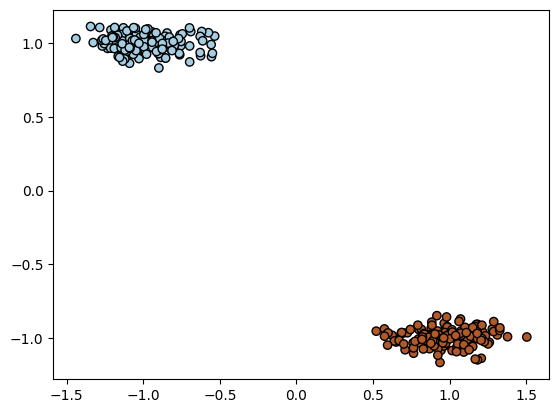

In [3]:
# Generate and visualize data blobs
X, y = generate_dataset('blobs', noise=0.1)
plt.scatter(X[:, 0], X[:, 1], c=y, cmap=plt.cm.Paired, edgecolors='k')
plt.show()

I anticipate that this data set [I predict this will be relatively easy to linearly and non-linearly classify. This is because the data has clear distinctions in the space.]

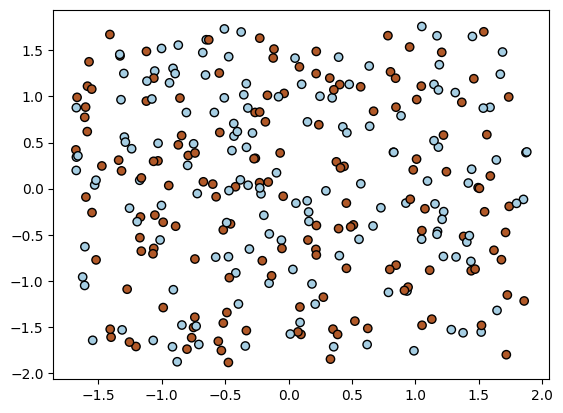

In [4]:
# Generate and visualize unstructured data
X, y = generate_dataset('unstructured')
plt.scatter(X[:, 0], X[:, 1], c=y, cmap=plt.cm.Paired, edgecolors='k')
plt.show()

I anticipate that this data set [I predict that this will be relatively difficult to classify. There is no clear pattern in the data.]

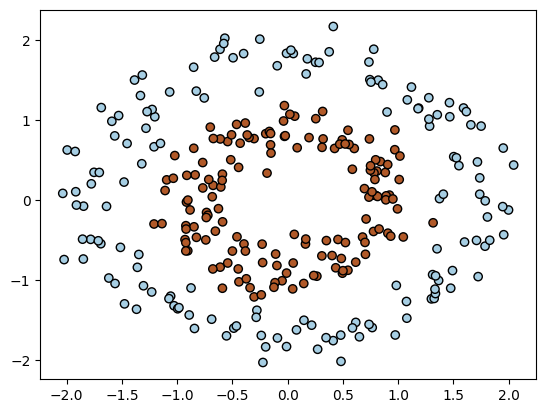

In [5]:
# Generate and visualize circles data set
X, y = generate_dataset('circles', noise=0.1)
plt.scatter(X[:, 0], X[:, 1], c=y, cmap=plt.cm.Paired, edgecolors='k')
plt.show()

I anticipate that this data set [I believe this will be relatively easy to classify with a non-linear classifier, but it will be harder to classify with a linear classifier.]

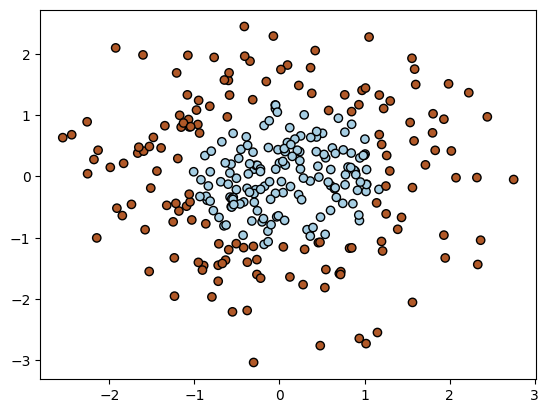

In [6]:
# Generate and visualize Gaussian quantiles
X, y = generate_dataset('quantiles', noise=0.1)
plt.scatter(X[:, 0], X[:, 1], c=y, cmap=plt.cm.Paired, edgecolors='k')
plt.show()

I anticipate that this data set [I anticipate that this data will be dificult to anticipate with a linear classifier. This will be relatively easy with a non-linear classifier however, because the spatial data is curved.]

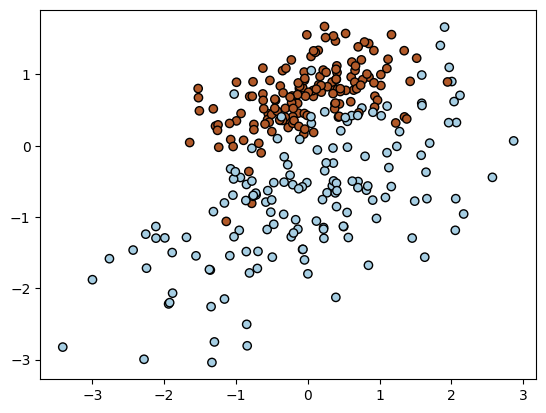

In [7]:
# Generate and visualize linearly separable data
X, y = generate_dataset('linearly_separable')
plt.scatter(X[:, 0], X[:, 1], c=y, cmap=plt.cm.Paired, edgecolors='k')
plt.show()

I anticipate that this data set [I believe this will be relatively easy to generally classify with a linear classifier. There is a semi-definite distinction between the blue and red, but it is not clear. This is the same for the non-linear classifier.]

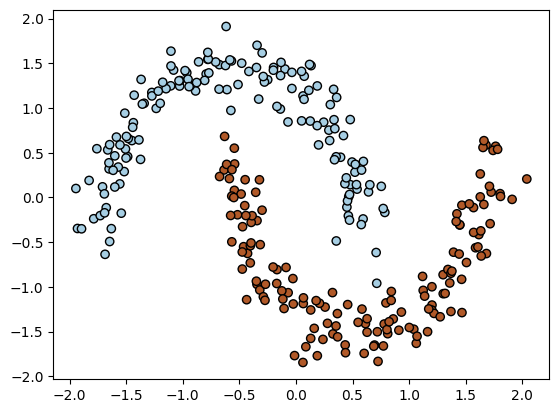

In [8]:
# Generate and visualize moons data set
X, y = generate_dataset('moons', noise=0.1)
plt.scatter(X[:, 0], X[:, 1], c=y, cmap=plt.cm.Paired, edgecolors='k')
plt.show()

I anticipate that this data set [easy for the non-linear but not as easy for the linear classifier. This is because there is a non-linear spatial relationship between the two.]

0
1


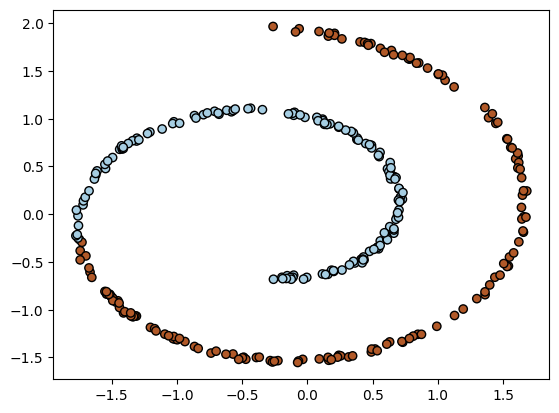

In [9]:
# Generate and visualize swiss role with 2 split sets
X, y = generate_dataset('swiss', noise=0.1, split=2)
plt.scatter(X[:, 0], X[:, 1], c=y, cmap=plt.cm.Paired, edgecolors='k')
plt.show()

I anticipate that this data set [I believe that this data set will be easy to classify with a linear and non-linear classifier because there is a clear spatial relationship between the red and the blue. With a simple linear evaulation of blue vs red, this should be easy to figure out.]

0
1


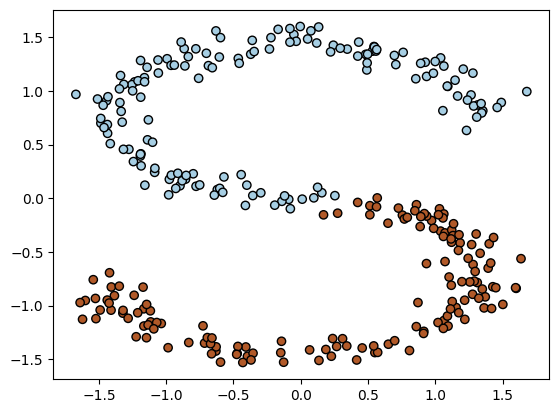

In [10]:
# Generate and visualize S curve with 2 split sets
X, y = generate_dataset('scurve', noise=0.1, split=2)
plt.scatter(X[:, 0], X[:, 1], c=y, cmap=plt.cm.Paired, edgecolors='k')
plt.show()

I anticipate that this data set [This will be easy with a linear and non-linear classifier. This is becasue there is a very clear linear distinction between the points.]

0
1
2
3
4
5
6
7
8
9


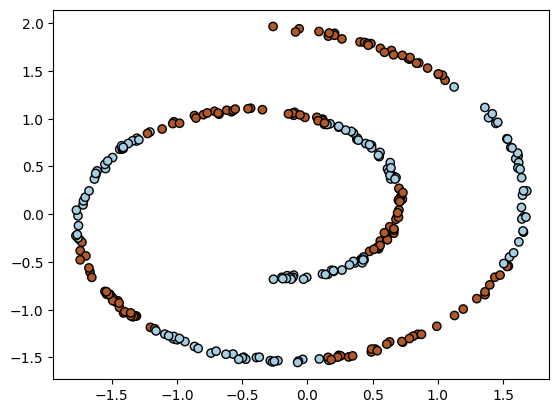

In [11]:
# Generate and visualize swiss role with 10 split sets
X, y = generate_dataset('swiss', noise=0.1, split=10)
plt.scatter(X[:, 0], X[:, 1], c=y, cmap=plt.cm.Paired, edgecolors='k')
plt.show()

I anticipate that this data set [will be difficult for a linear but not difficult for a non-linear classifier. This is because the data does not vary linearly, but it does vary with a clear pattern that a non-linear classifier will be able to pick up.]

0
1
2
3
4
5
6
7
8
9


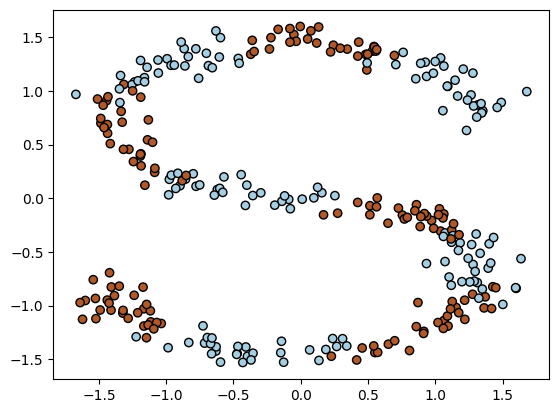

In [12]:
# Generate and visualize S curve with 10 split sets
X, y = generate_dataset('scurve', noise=0.1, split=10)
plt.scatter(X[:, 0], X[:, 1], c=y, cmap=plt.cm.Paired, edgecolors='k')
plt.show()

I anticipate that this data set [will be difficult for a linear but not difficult for a non-linear classifier. This is because the data does not vary linearly, but it does vary with a clear pattern that a non-linear classifier will be able to pick up.]. 

### Part 1.2: SVM with nonlinear kernels

The next cell defines the function `kernel_comparison`, which you can use to visually compare the decision boundaries generated by SVMs with different kernels. 

1. The kernel comparison currently produces only visual results. Add code to the function so that it also outputs train and test accuracy of the different SVMs. (Note: Think carefully about where the right place in the code is to do a train-test split.)
2. Run the kernel comparison for the data sets from Part 1.1. Do the results confirm or contradict your expectations that you formulated in Part 1.1.? Did any of the results surprise you?
3. Consult sklearn's documentation to learn how the keyword arguments `degree` and `gamma` affect your classifier. Try out a few different values of these parameters. How and what can one infer from the shape of the decision boundary about the classifier's `degree` or `gamma`?

In [19]:
from sklearn.model_selection import train_test_split

def kernel_comparison(X, y, support_vectors=True, tight_box=False, if_flag=False, degree=3, gamma=3, quant=False):
    if quant:
        # Train-test split at the top of the function, before the for loop
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)
        result = {}
        for ikernel, kernel in enumerate(['linear', 'poly', 'rbf', 'sigmoid']):
            # Define the SVC
            clf = SVC(kernel=kernel, degree=degree, gamma=gamma).fit(X_train, y_train)

            # Train the SVC
            clf.fit(X_train, y_train)

            # Calculate train and test accuracy
            train_accuracy = clf.score(X_train, y_train)
            test_accuracy = clf.score(X_test, y_test)

            result[kernel] = (train_accuracy, test_accuracy)

        return result

    if if_flag:
        fig, axs = plt.subplots(2, 2)
    else:
        fig = plt.figure(figsize=(10,3))

    # Train-test split at the top of the function, before the for loop
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)
    
    for ikernel, kernel in enumerate(['linear', 'poly', 'rbf', 'sigmoid']):
        # Define the SVC
        clf = SVC(kernel=kernel, degree=degree, gamma=gamma).fit(X_train, y_train)

        # Train the SVC
        clf.fit(X_train, y_train)

        # Calculate train and test accuracy
        train_accuracy = clf.score(X_train, y_train)
        test_accuracy = clf.score(X_test, y_test)

        # Settings for plotting
        if if_flag:
            ax = axs.flatten()[ikernel]
            # Set plot range to match aspect ratio of flag
            
        else:
            ax = plt.subplot(1,4,1+ikernel)

        # Plot decision boundary and margins
        common_params = {"estimator": clf, "X": X, "ax": ax}
        DecisionBoundaryDisplay.from_estimator(
            **common_params,
            response_method="predict",
            plot_method="pcolormesh",
            alpha=0.3,
        )
        DecisionBoundaryDisplay.from_estimator(
            **common_params,
            response_method="decision_function",
            plot_method="contour",
            levels=[-1, 0, 1],
            colors=["k", "k", "k"],
            linestyles=["--", "-", "--"],
        )

        if support_vectors:
            # Plot bigger circles around samples that serve as support vectors
            ax.scatter(
                clf.support_vectors_[:, 0],
                clf.support_vectors_[:, 1],
                s=150,
                facecolors="none",
                edgecolors="k",
            )
    
        # Plot samples by color and add legend
        ax.scatter(X[:, 0], X[:, 1], c=y, s=30, edgecolors="k")
        ax.set_title(kernel)
        ax.axis('off')
        if tight_box:
            ax.set_xlim([X[:, 0].min(), X[:, 0].max()])
            ax.set_ylim([X[:, 1].min(), X[:, 1].max()])

        # Print train and test accuracy
        ax.text(0.5, -0.1, f"Train Accuracy: {train_accuracy:.2f}\nTest Accuracy: {test_accuracy:.2f}", 
                    size=10, ha="center", transform=ax.transAxes)            

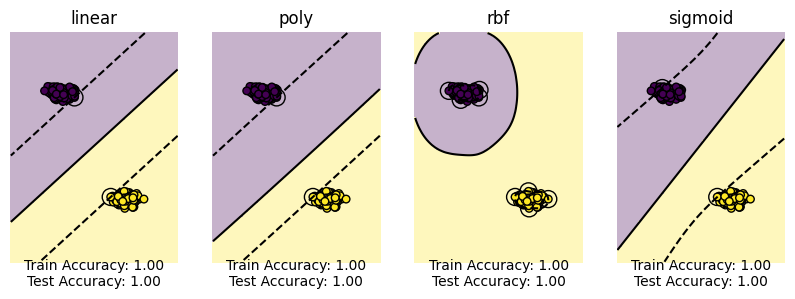

In [46]:
# Show results of kernel comparison for data sets from part 1
X, y = generate_dataset('blobs', noise=0.1)
kernel_comparison(X, y, support_vectors=True, tight_box=False, if_flag=True)

To summarize the results of the kernel comparison, [All methods did a good job differentiating the data. The rbf model had a very distinctly different generalization of the classification than the other models]. 

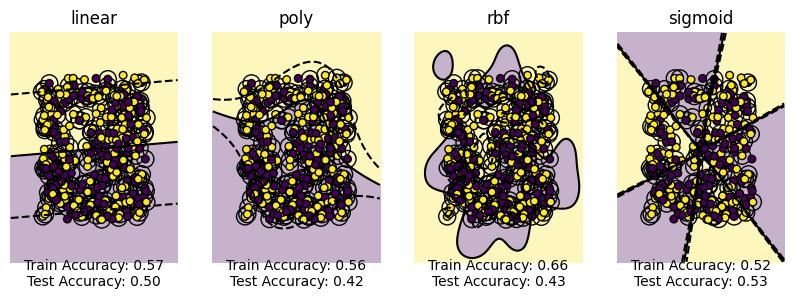

In [47]:
X, y = generate_dataset('unstructured')
kernel_comparison(X, y, support_vectors=True, tight_box=False, if_flag=True)

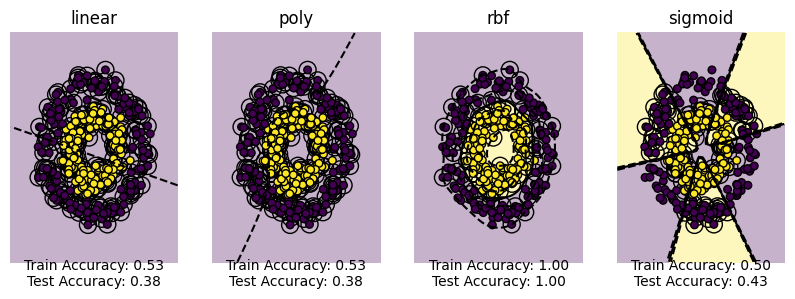

In [48]:
X, y = generate_dataset('circles', noise=0.1)
kernel_comparison(X, y, support_vectors=True, tight_box=False, if_flag=True)

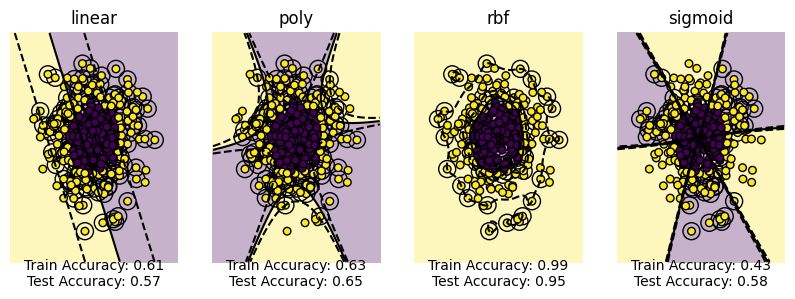

In [49]:
X, y = generate_dataset('quantiles', noise=0.1)
kernel_comparison(X, y, support_vectors=True, tight_box=False, if_flag=True)

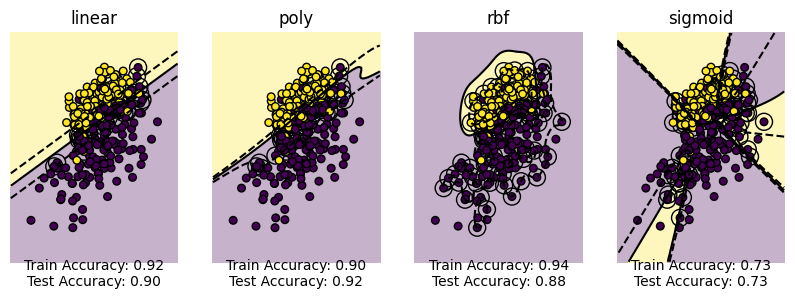

In [50]:
X, y = generate_dataset('linearly_separable')
kernel_comparison(X, y, support_vectors=True, tight_box=False, if_flag=True)

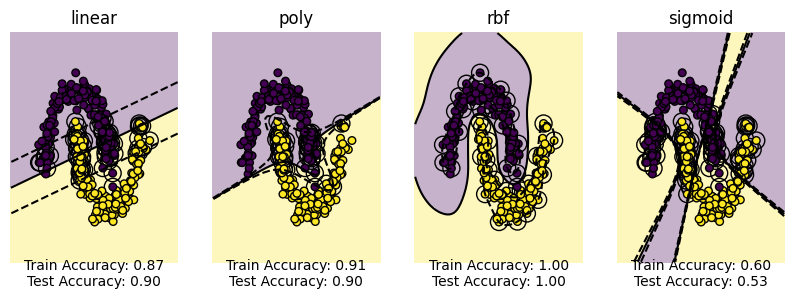

In [51]:
X, y = generate_dataset('moons', noise=0.1)
kernel_comparison(X, y, support_vectors=True, tight_box=False, if_flag=True)

0
1


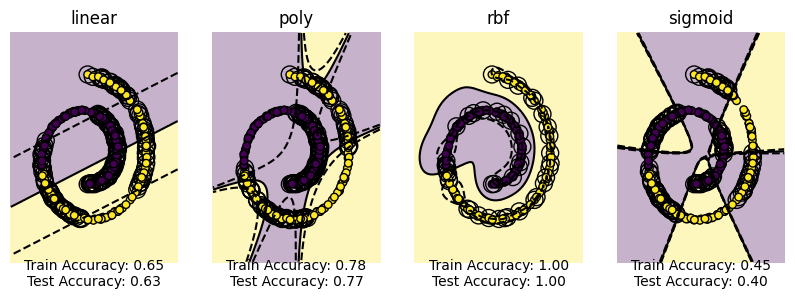

In [52]:
X, y = generate_dataset('swiss', noise=0.1, split=2)
kernel_comparison(X, y, support_vectors=True, tight_box=False, if_flag=True)

0
1


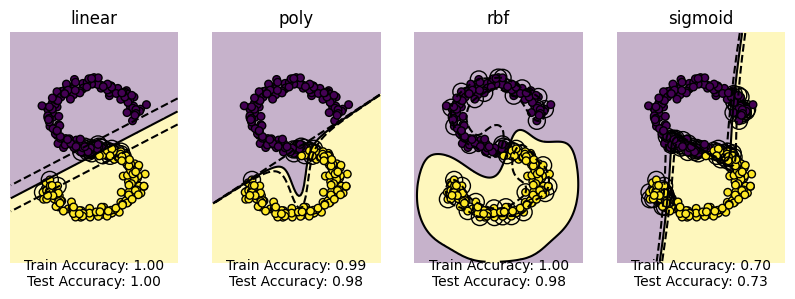

In [53]:
X, y = generate_dataset('scurve', noise=0.1, split=2)
kernel_comparison(X, y, support_vectors=True, tight_box=False, if_flag=True)

0
1
2
3
4
5
6
7
8
9


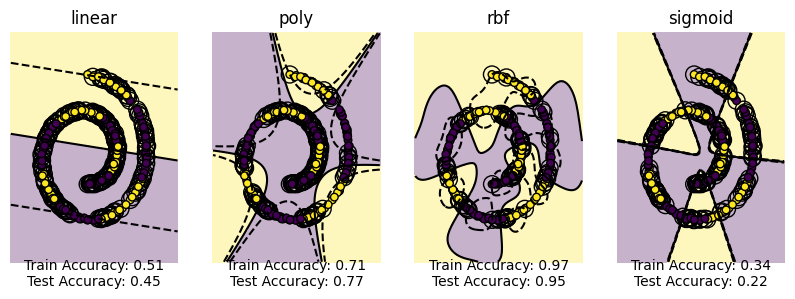

In [54]:
X, y = generate_dataset('swiss', noise=0.1, split=10)
kernel_comparison(X, y, support_vectors=True, tight_box=False, if_flag=True)

0
1
2
3
4
5
6
7
8
9


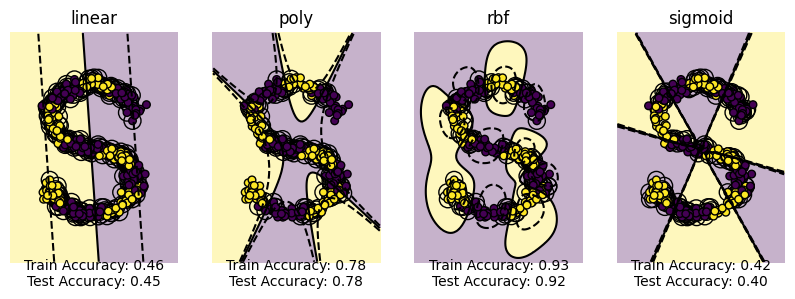

In [55]:
X, y = generate_dataset('scurve', noise=0.1, split=10)
kernel_comparison(X, y, support_vectors=True, tight_box=False, if_flag=True)

To generally summarize the results of the kernel comparison, [Different methods did better jobs at different datasets. THe poly and rbf methods generally did better or the same as the linear method accross different data sets. However, the sigmoid sometimes underperformed the linear kernel. The sigmoid was generally the worst performing. However, the lowest score that these models would get in train and test accuracy would usually have a floor at around 0.5. This makes sense as the worse you could do with a binary classifier is just guess, which would give you around 50/50 if there was an equal amount of each prediction type in the test set.]. 

Degree: 1, Gamma: 0.1


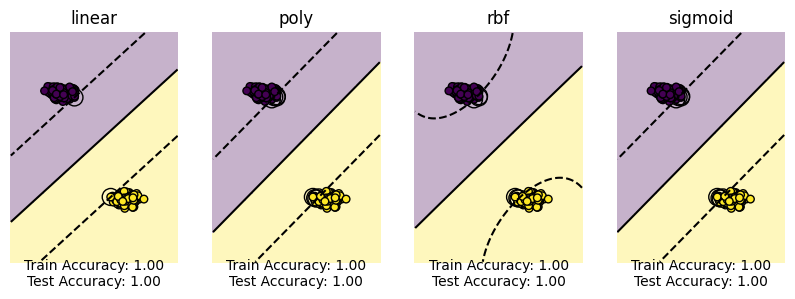

Degree: 1, Gamma: 1


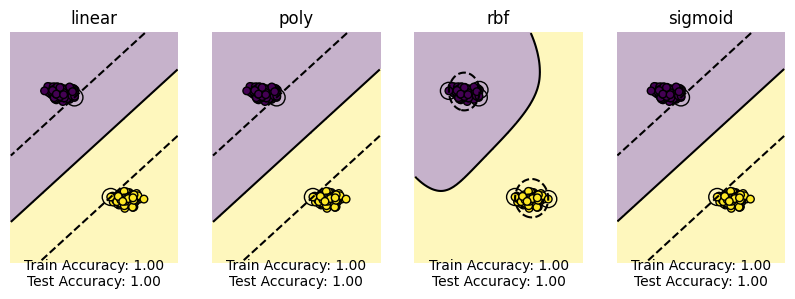

Degree: 1, Gamma: 10


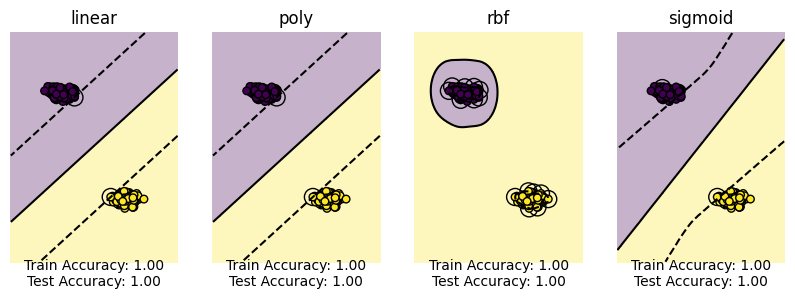

Degree: 1, Gamma: 100


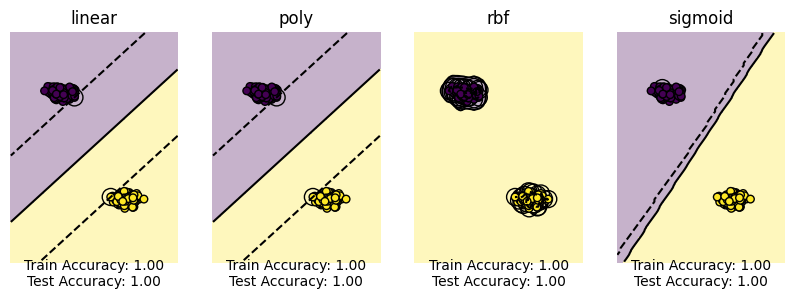

Degree: 2, Gamma: 0.1


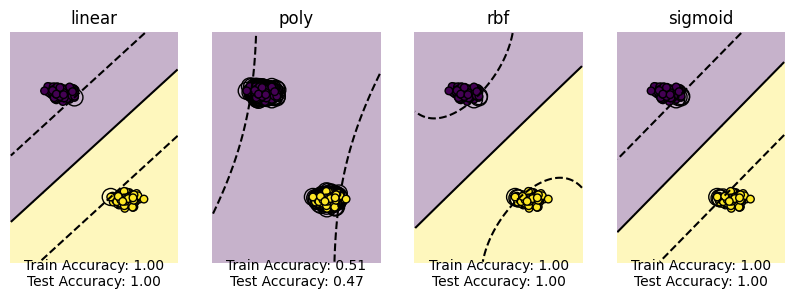

Degree: 2, Gamma: 1


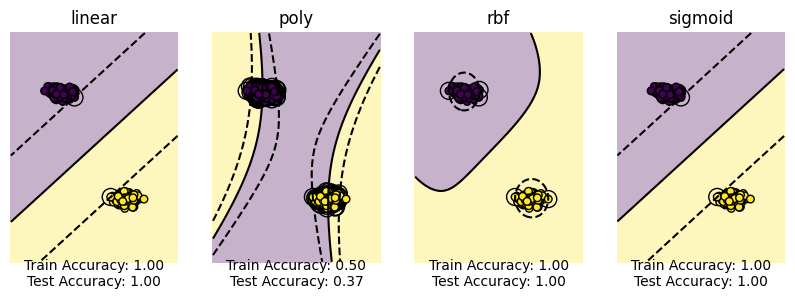

Degree: 2, Gamma: 10


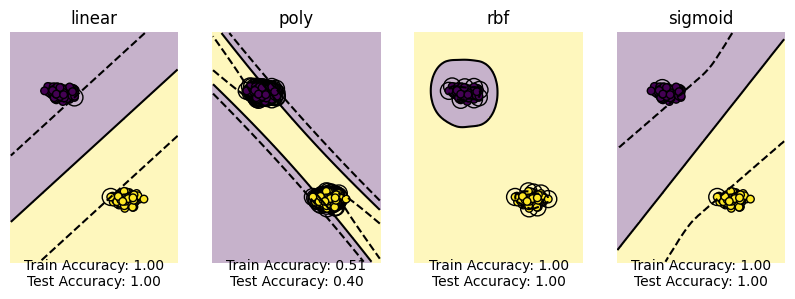

Degree: 2, Gamma: 100


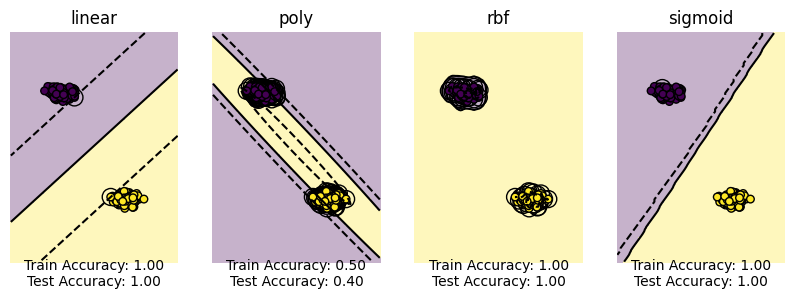

Degree: 3, Gamma: 0.1


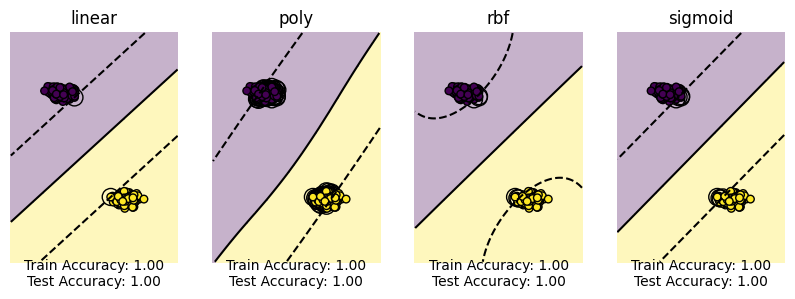

Degree: 3, Gamma: 1


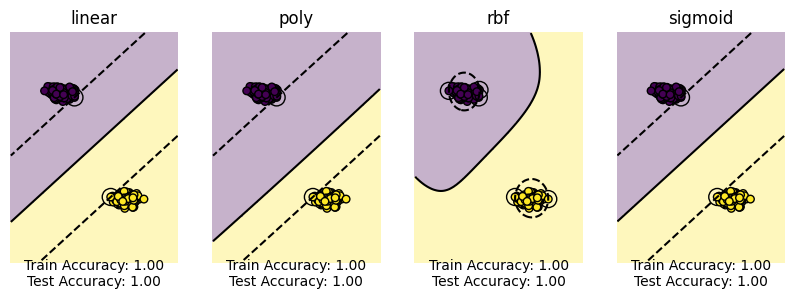

Degree: 3, Gamma: 10


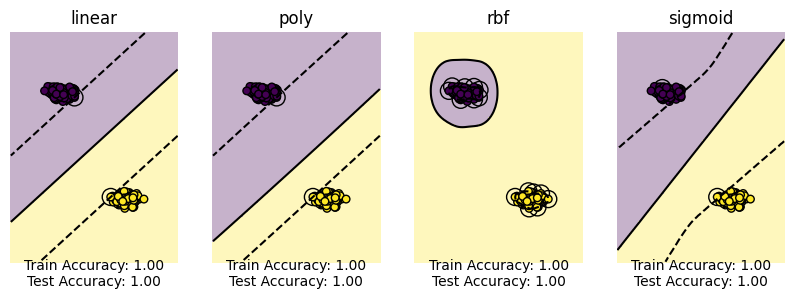

Degree: 3, Gamma: 100


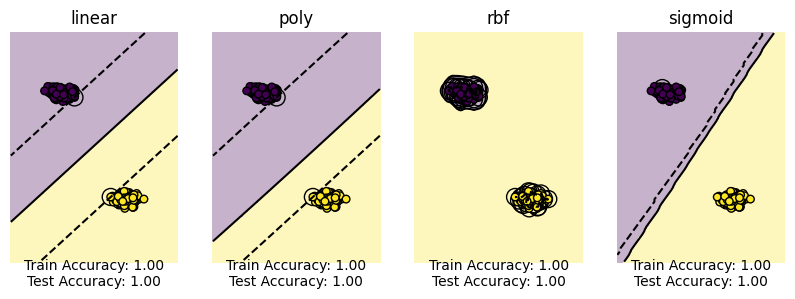

Degree: 4, Gamma: 0.1


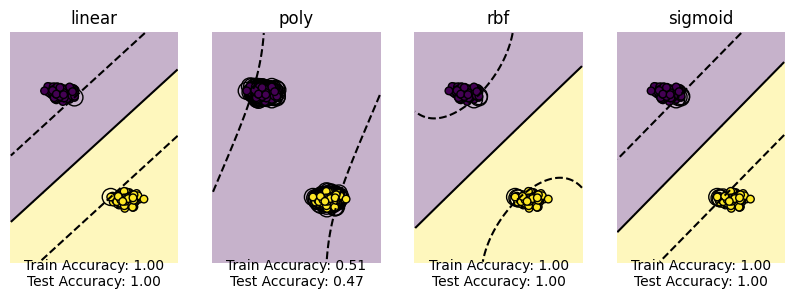

Degree: 4, Gamma: 1


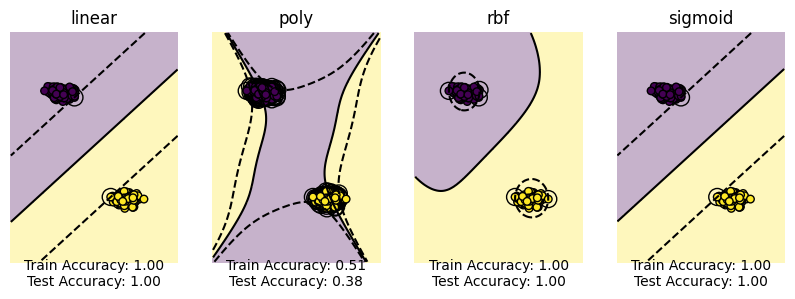

Degree: 4, Gamma: 10


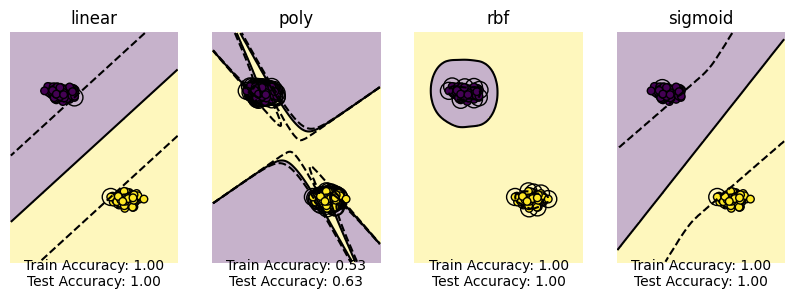

Degree: 4, Gamma: 100


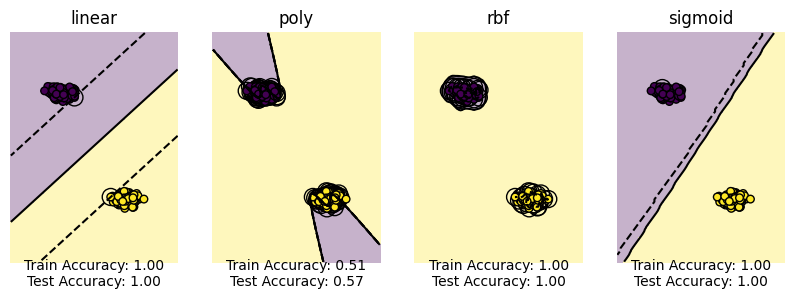

In [59]:
# Examine effect of degree and gamma keyword

# Iterate through different degrees and gammas for the blobs dataset
for degree in [1, 2, 3, 4]:
    for gamma in [0.1, 1, 10, 100]:
        print(f"Degree: {degree}, Gamma: {gamma}")
        X, y = generate_dataset('blobs', noise=0.1)
        kernel_comparison(X, y, support_vectors=True, tight_box=False, if_flag=True, degree=degree, gamma=gamma)
        plt.show()



Degree: 1, Gamma: 0.1


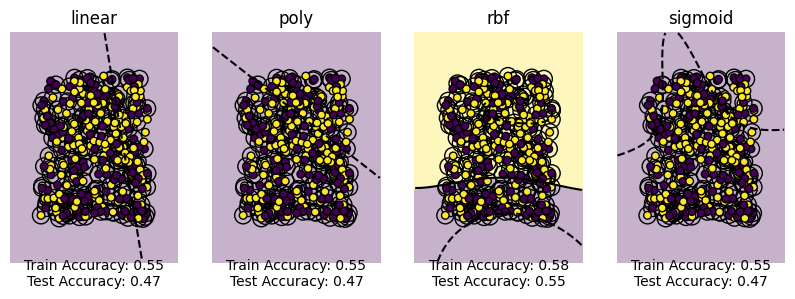

Degree: 1, Gamma: 1


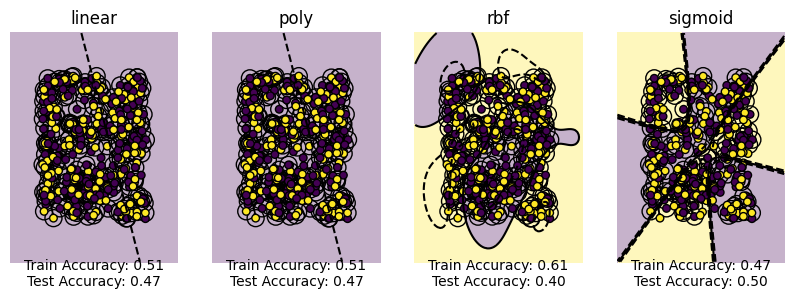

Degree: 1, Gamma: 10


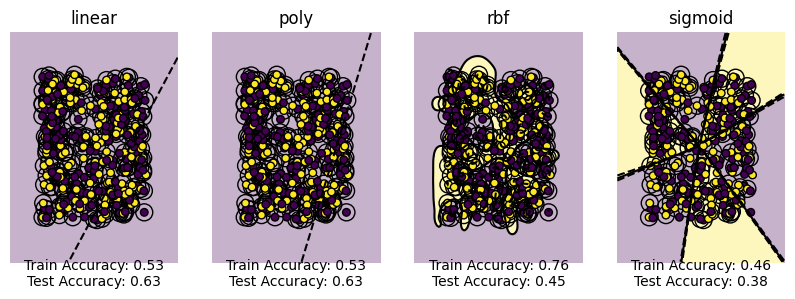

Degree: 1, Gamma: 100


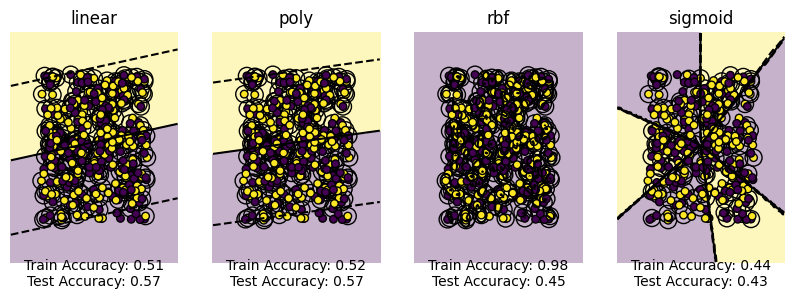

Degree: 2, Gamma: 0.1


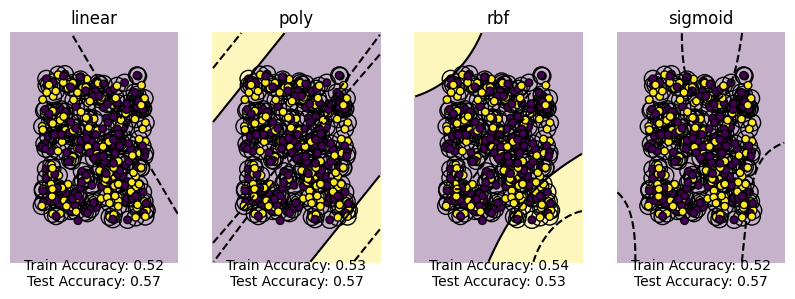

Degree: 2, Gamma: 1


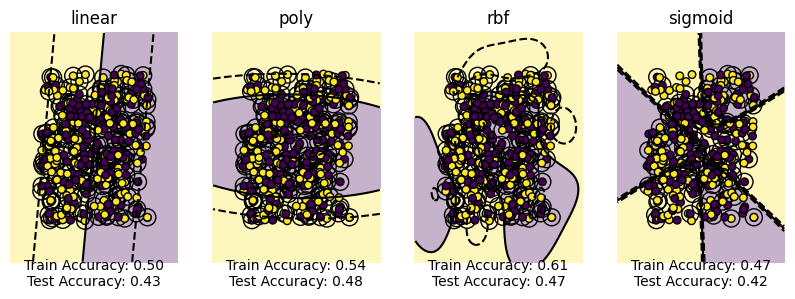

Degree: 2, Gamma: 10


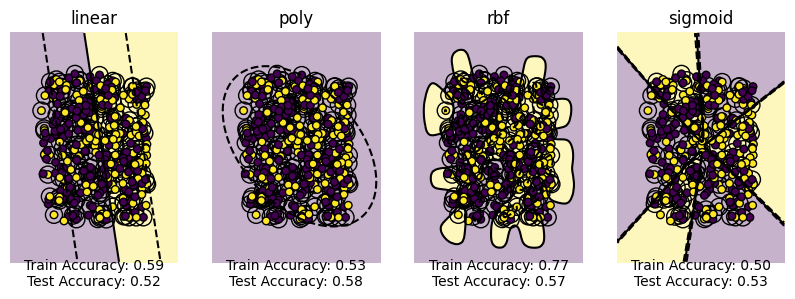

Degree: 2, Gamma: 100


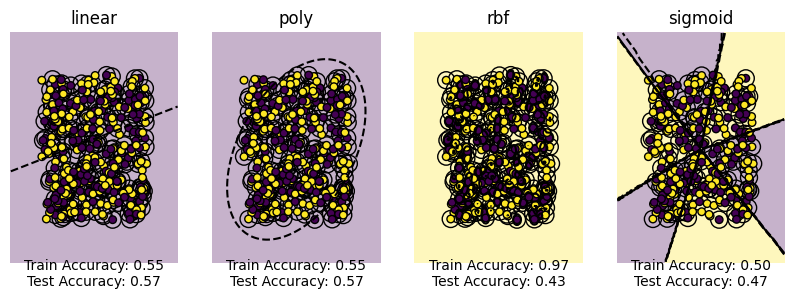

Degree: 3, Gamma: 0.1


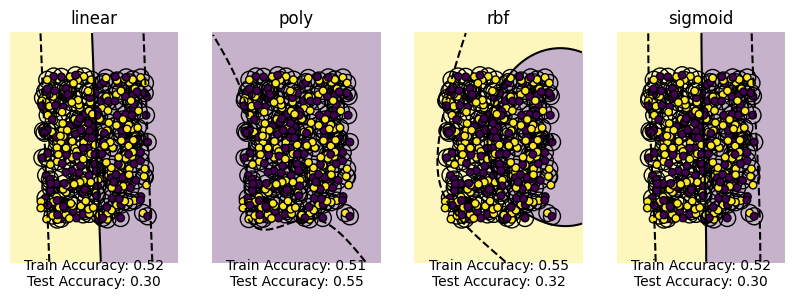

Degree: 3, Gamma: 1


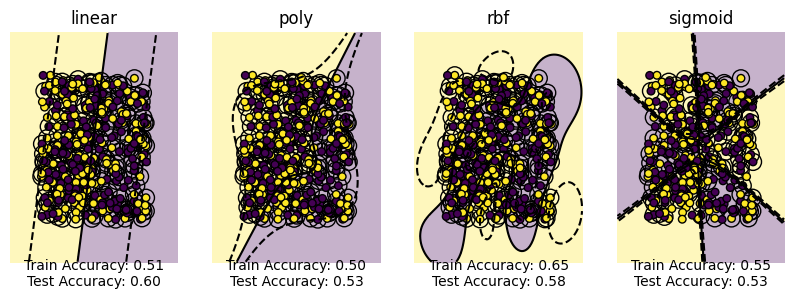

Degree: 3, Gamma: 10


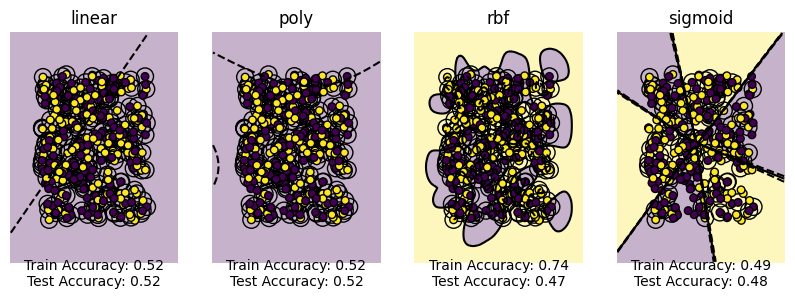

Degree: 3, Gamma: 100


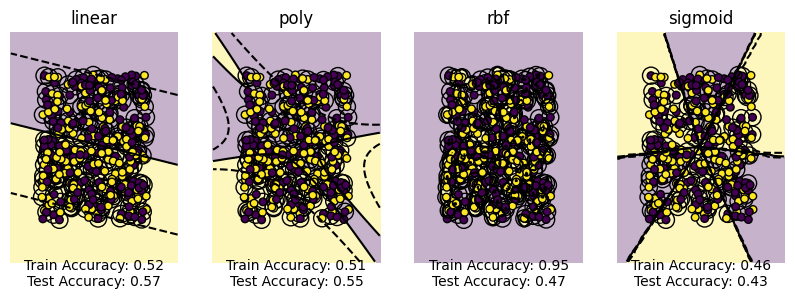

Degree: 4, Gamma: 0.1


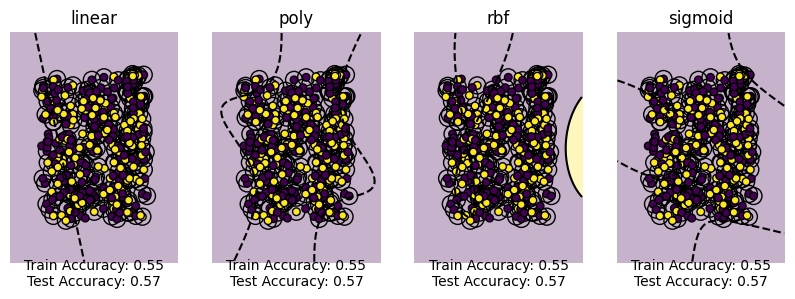

Degree: 4, Gamma: 1


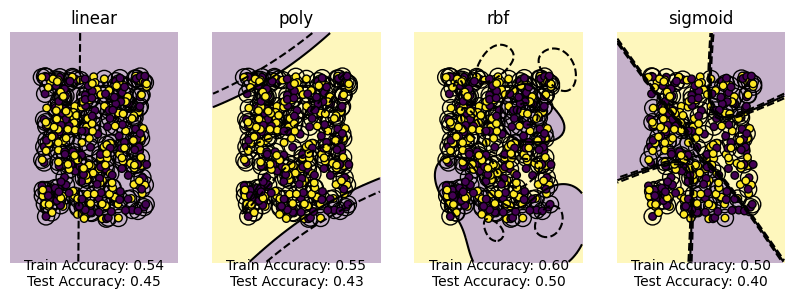

Degree: 4, Gamma: 10


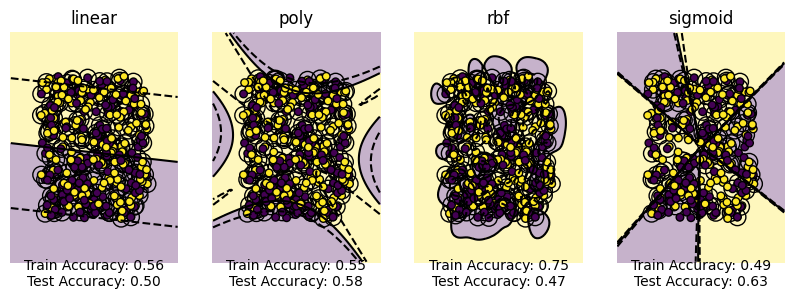

Degree: 4, Gamma: 100


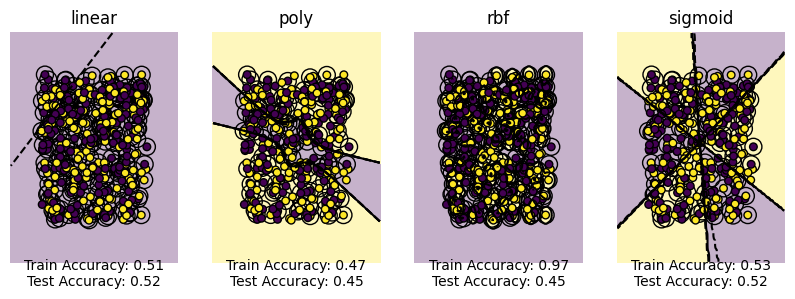

In [5]:
# Examine effect of degree and gamma keyword for the unstructured dataset
for degree in [1, 2, 3, 4]:
    for gamma in [0.1, 1, 10, 100]:
        print(f"Degree: {degree}, Gamma: {gamma}")
        X, y = generate_dataset('unstructured')
        kernel_comparison(X, y, support_vectors=True, tight_box=False, if_flag=True, degree=degree, gamma=gamma)
        plt.show()

Degree: 1, Gamma: 0.1


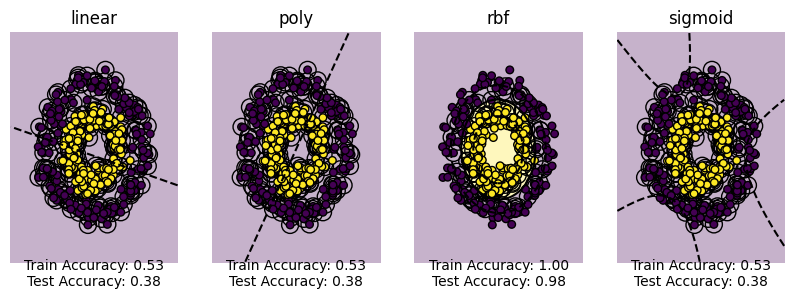

Degree: 1, Gamma: 1


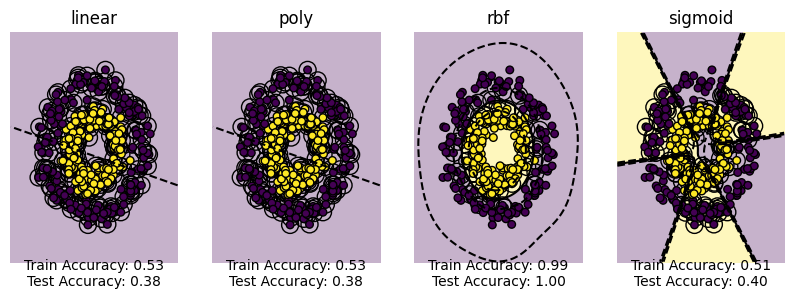

Degree: 1, Gamma: 5


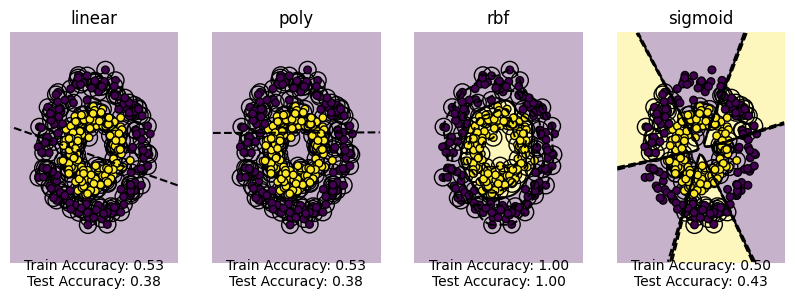

Degree: 1, Gamma: 50


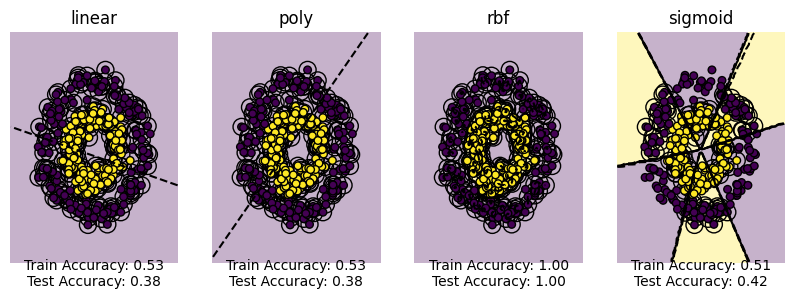

Degree: 2, Gamma: 0.1


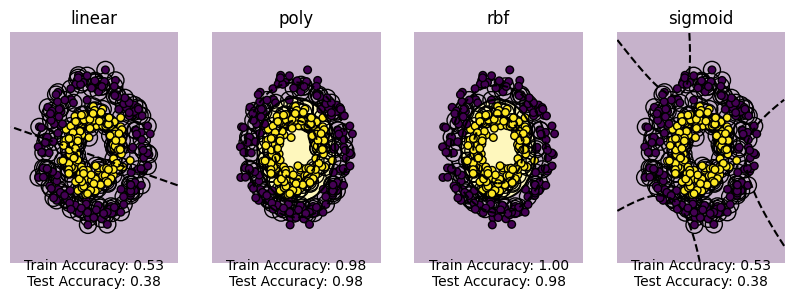

Degree: 2, Gamma: 1


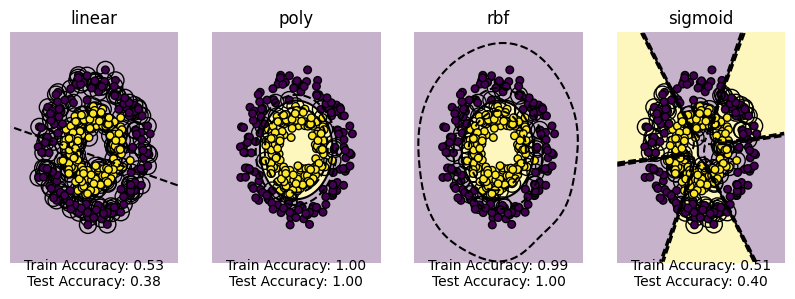

Degree: 2, Gamma: 5


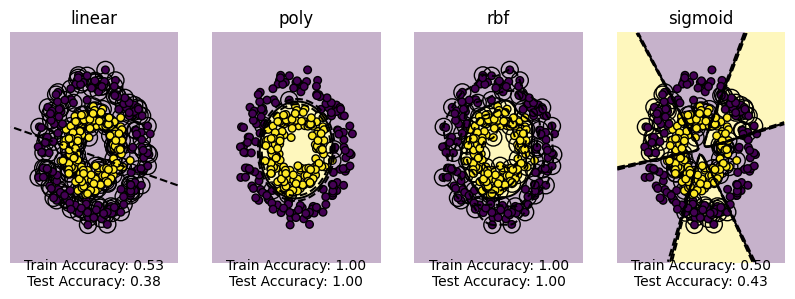

Degree: 2, Gamma: 50


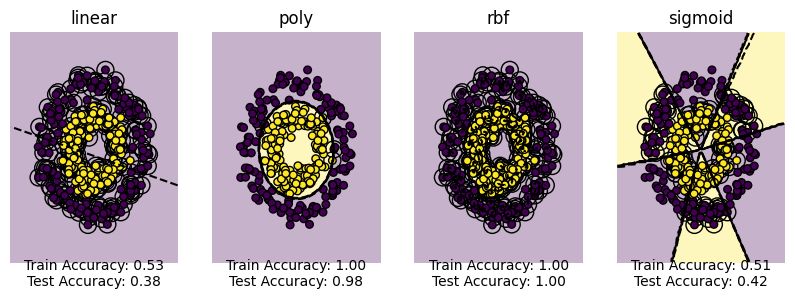

Degree: 3, Gamma: 0.1


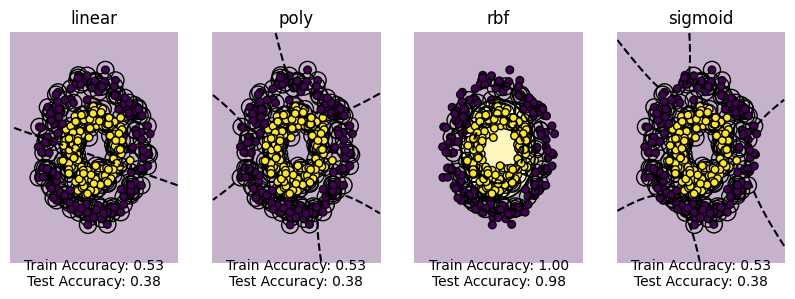

Degree: 3, Gamma: 1


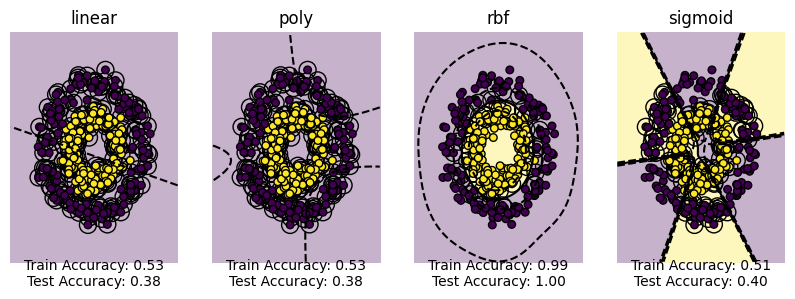

Degree: 3, Gamma: 5


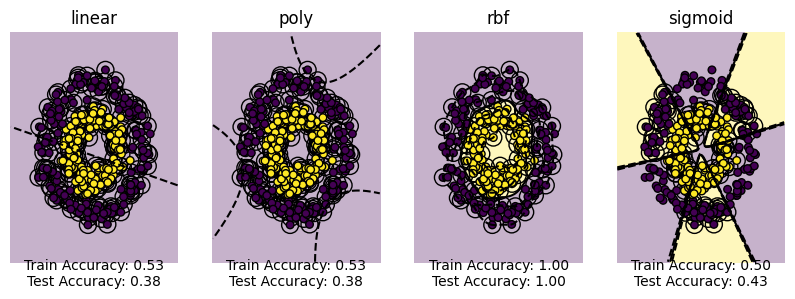

Degree: 3, Gamma: 50


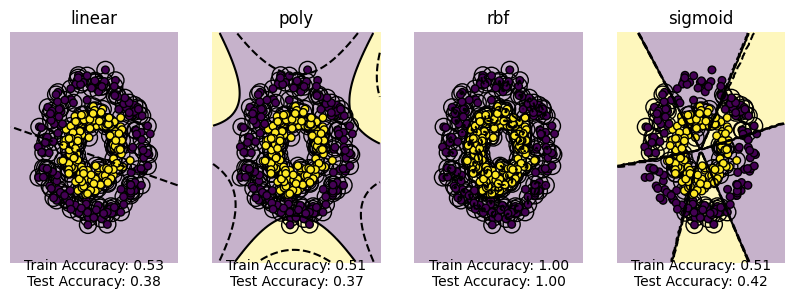

Degree: 4, Gamma: 0.1


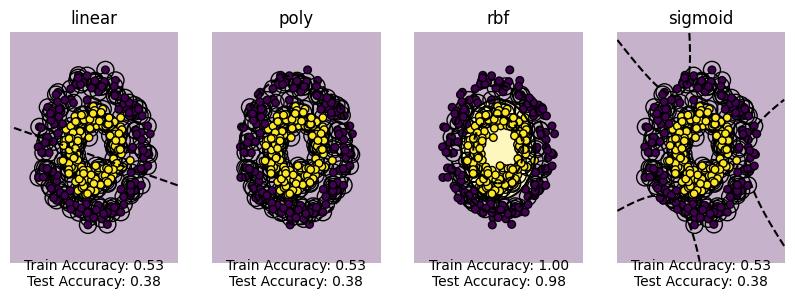

Degree: 4, Gamma: 1


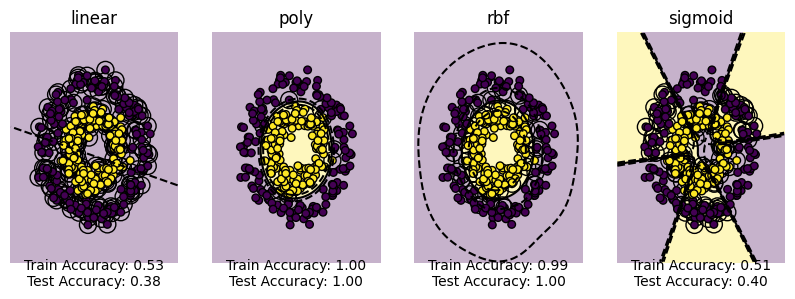

Degree: 4, Gamma: 5


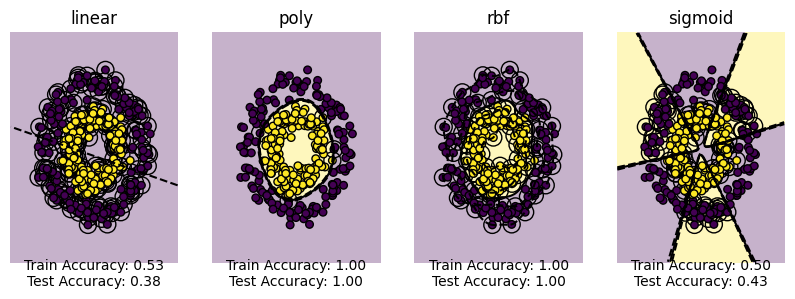

Degree: 4, Gamma: 50


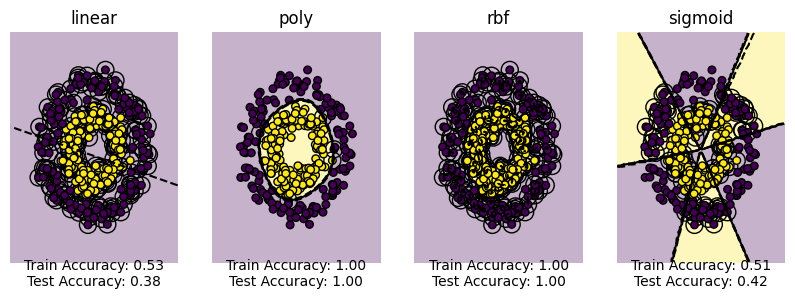

In [5]:
# Examine effect of degree and gamma keyword for the circles dataset
for degree in [1, 2, 3, 4]:
    for gamma in [0.1, 1, 5, 50]:
        print(f"Degree: {degree}, Gamma: {gamma}")
        X, y = generate_dataset('circles', noise=0.1)
        kernel_comparison(X, y, support_vectors=True, tight_box=False, if_flag=True, degree=degree, gamma=gamma)
        plt.show()

Degree: 1, Gamma: 0.1


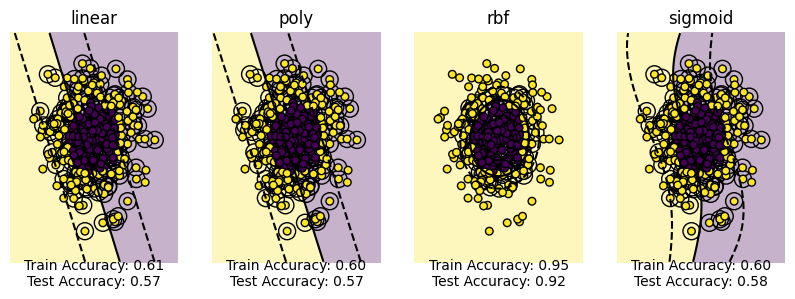

Degree: 1, Gamma: 1


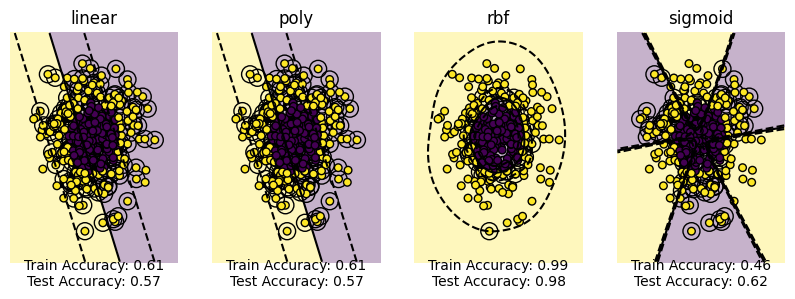

Degree: 1, Gamma: 5


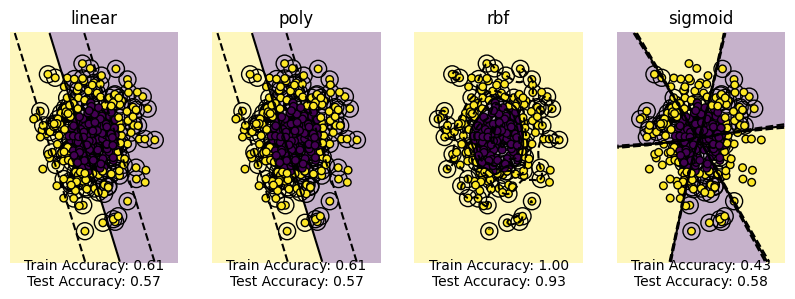

Degree: 1, Gamma: 50


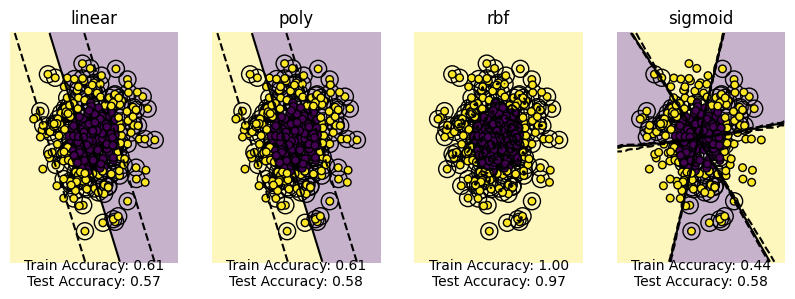

Degree: 2, Gamma: 0.1


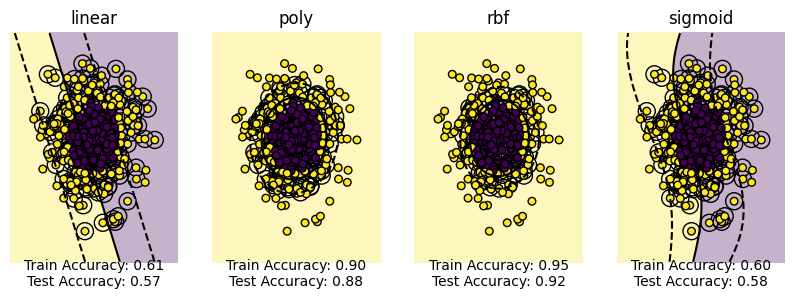

Degree: 2, Gamma: 1


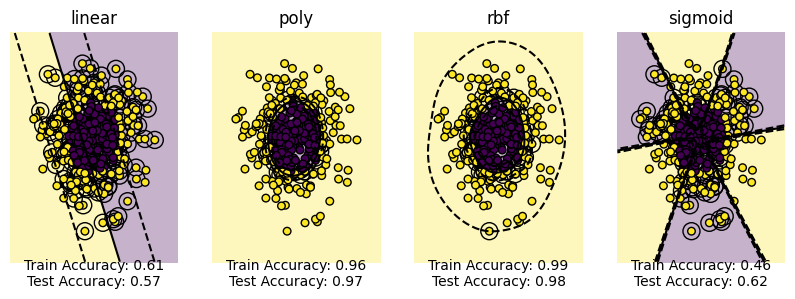

Degree: 2, Gamma: 5


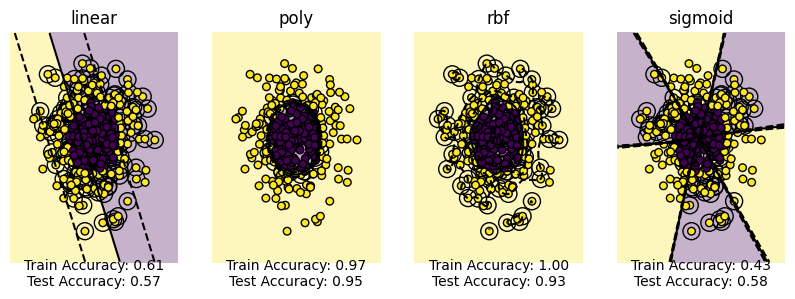

Degree: 2, Gamma: 50


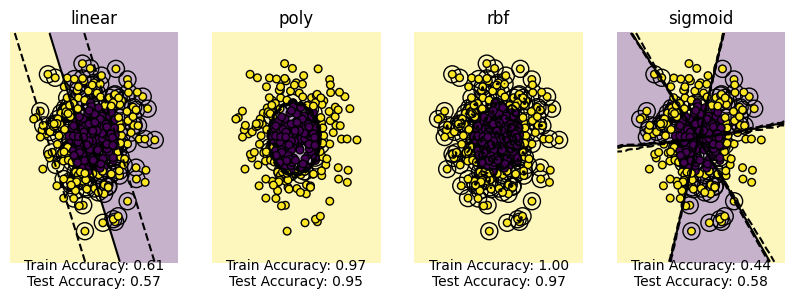

Degree: 3, Gamma: 0.1


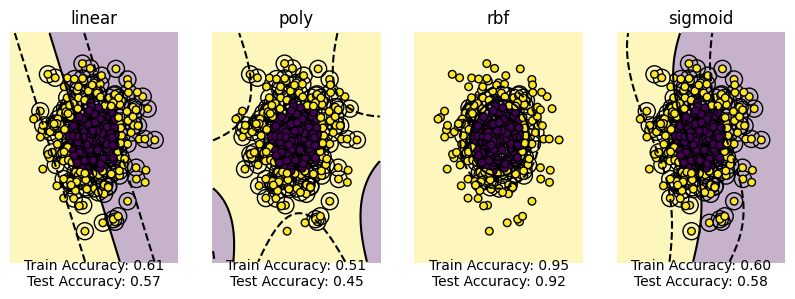

Degree: 3, Gamma: 1


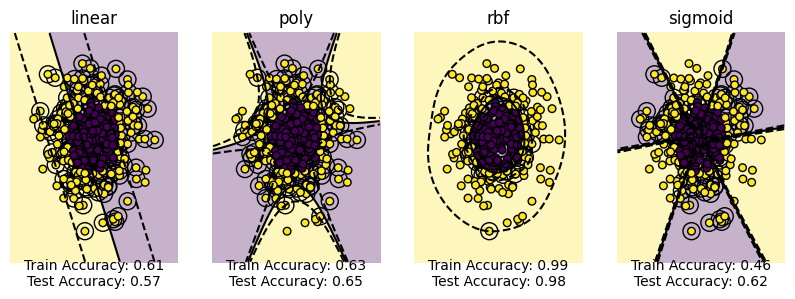

Degree: 3, Gamma: 5


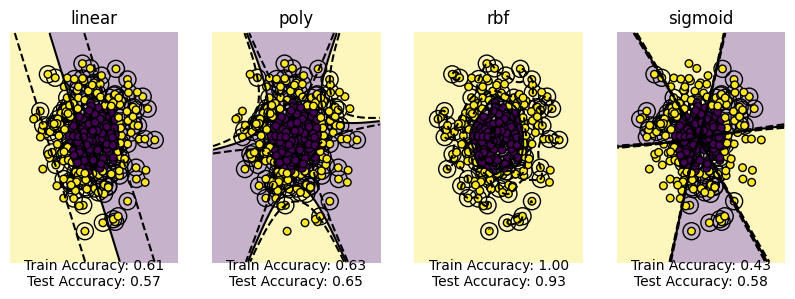

Degree: 3, Gamma: 50


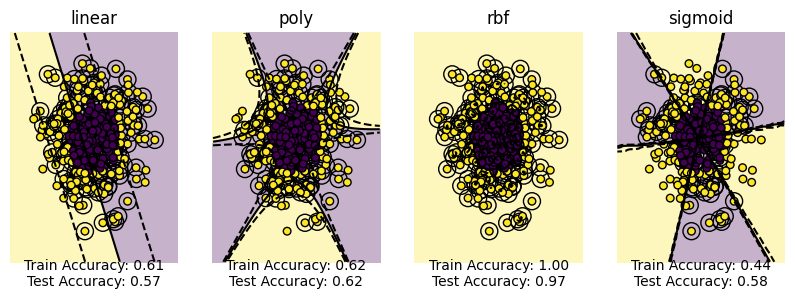

Degree: 4, Gamma: 0.1


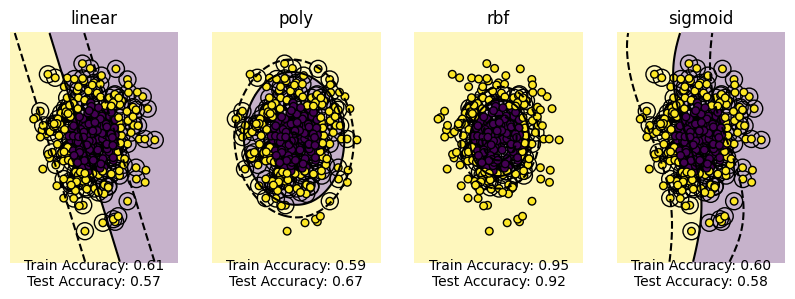

Degree: 4, Gamma: 1


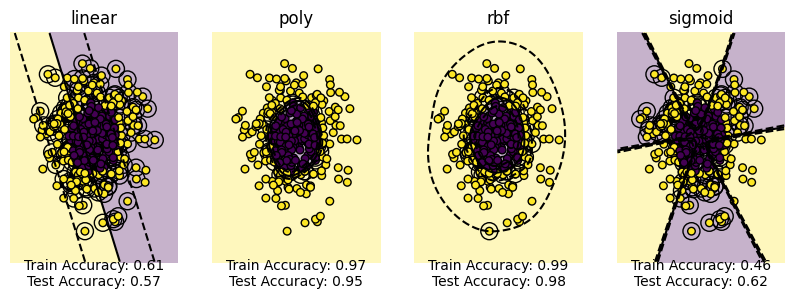

Degree: 4, Gamma: 5


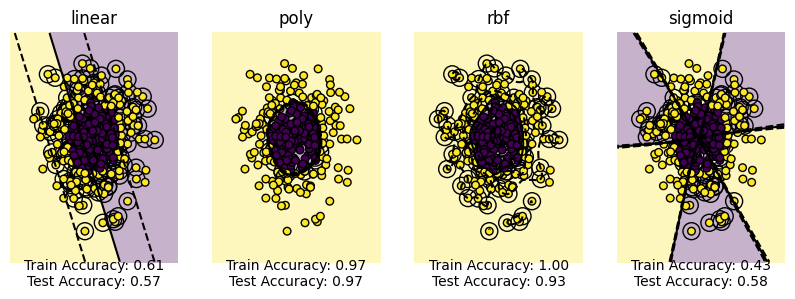

Degree: 4, Gamma: 50


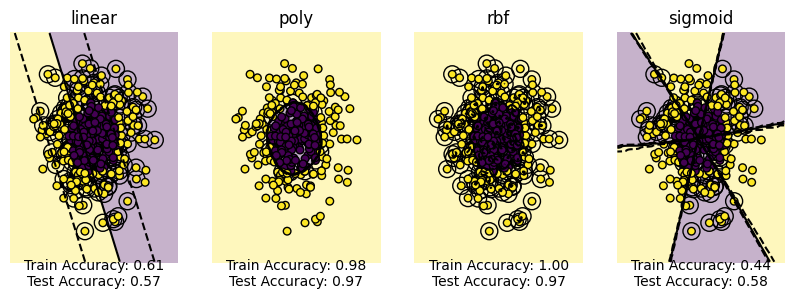

In [6]:
# Examine effect of degree and gamma keyword for the quantiles dataset
for degree in [1, 2, 3, 4]:
    for gamma in [0.1, 1, 5, 50]:
        print(f"Degree: {degree}, Gamma: {gamma}")
        X, y = generate_dataset('quantiles', noise=0.1)
        kernel_comparison(X, y, support_vectors=True, tight_box=False, if_flag=True, degree=degree, gamma=gamma)
        plt.show()

Degree: 1, Gamma: 0.1


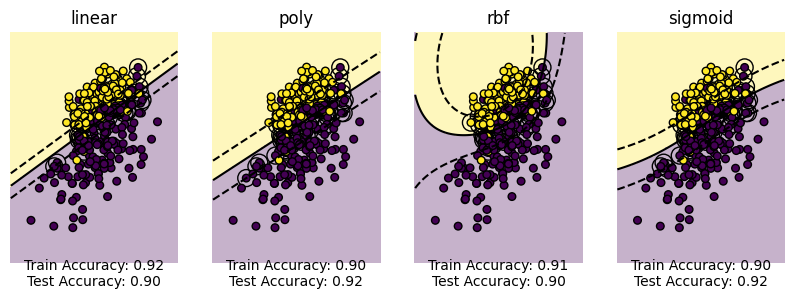

Degree: 1, Gamma: 1


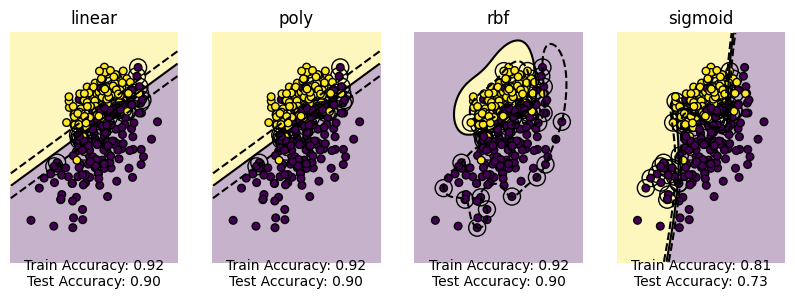

Degree: 1, Gamma: 5


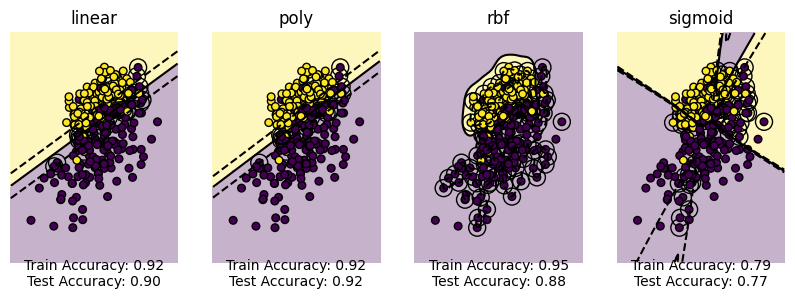

Degree: 1, Gamma: 50


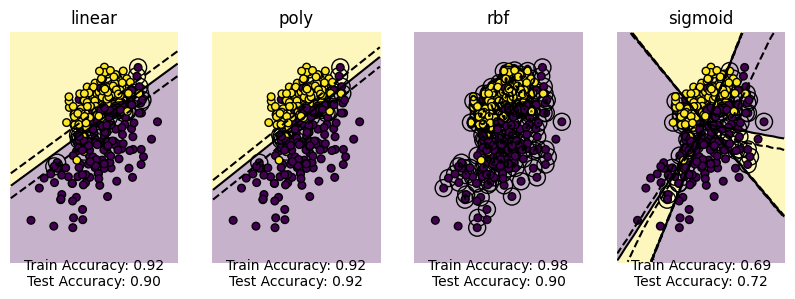

Degree: 2, Gamma: 0.1


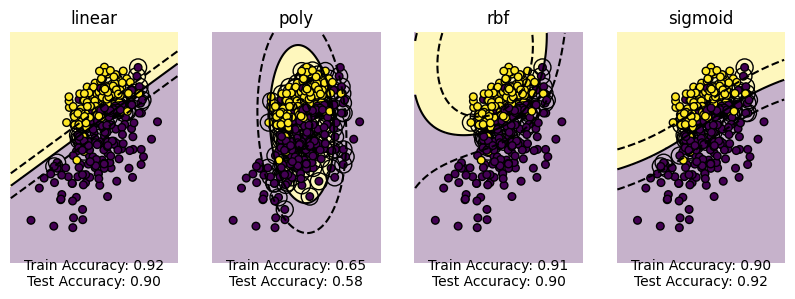

Degree: 2, Gamma: 1


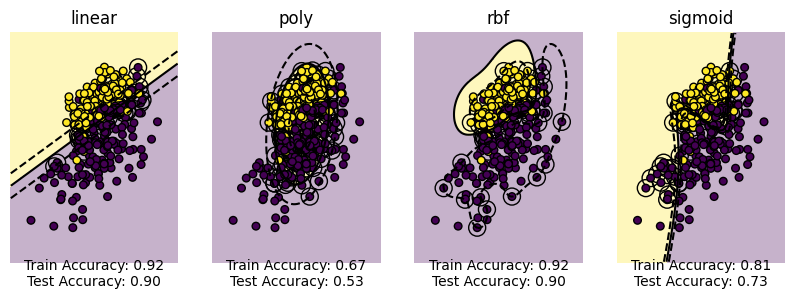

Degree: 2, Gamma: 5


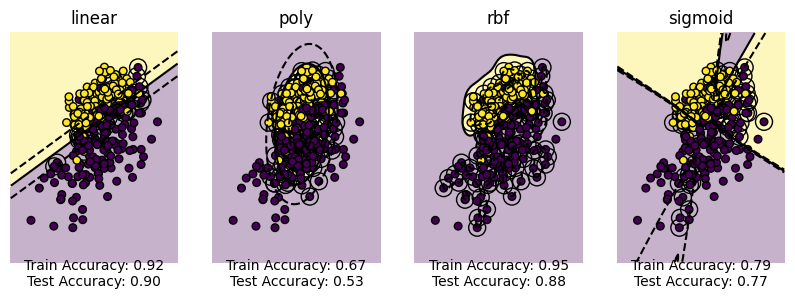

Degree: 2, Gamma: 50


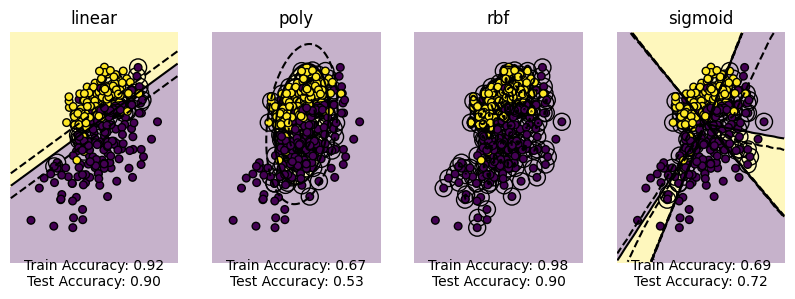

Degree: 3, Gamma: 0.1


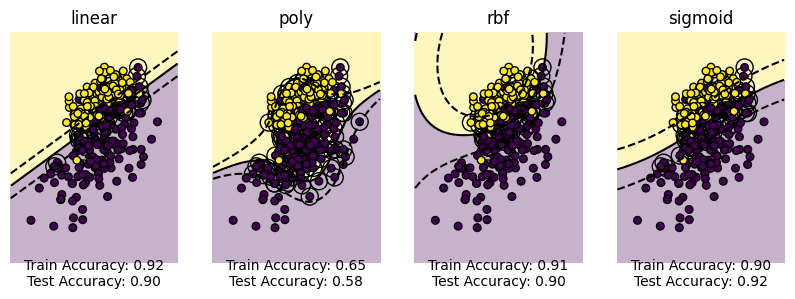

Degree: 3, Gamma: 1


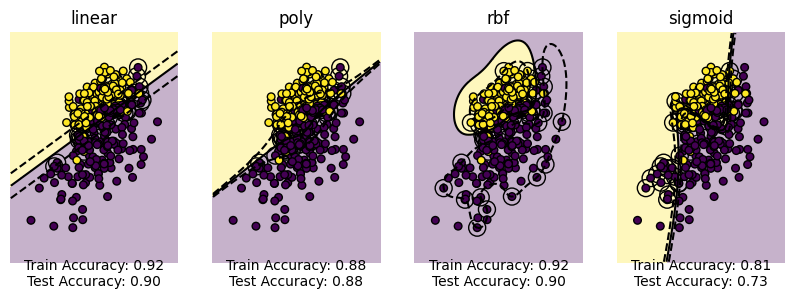

Degree: 3, Gamma: 5


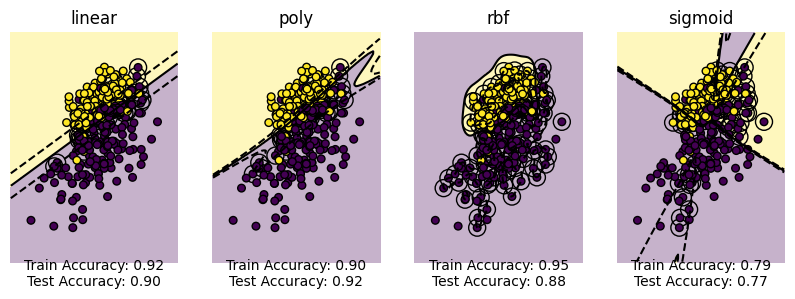

Degree: 3, Gamma: 50


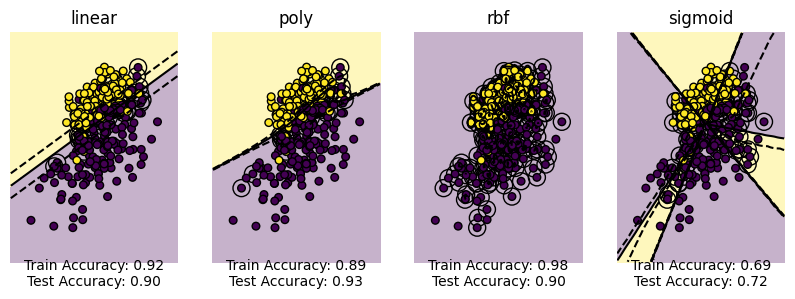

Degree: 4, Gamma: 0.1


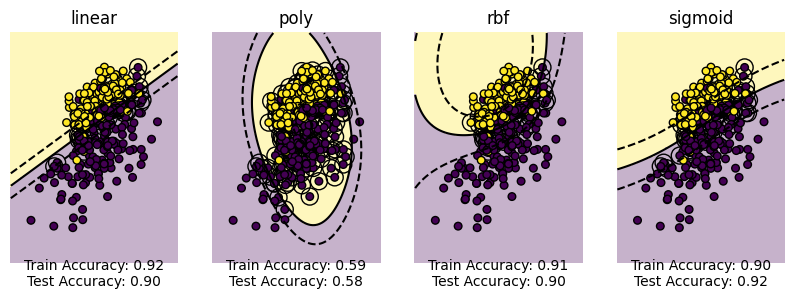

Degree: 4, Gamma: 1


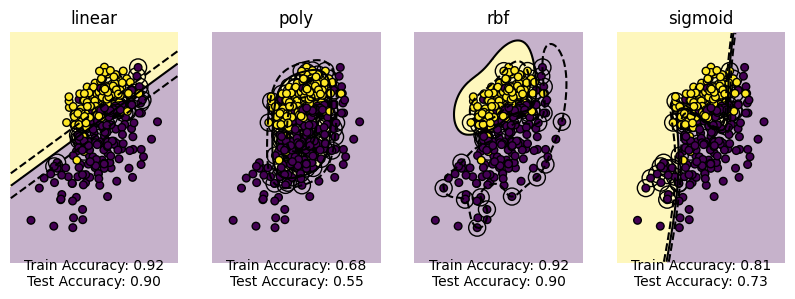

Degree: 4, Gamma: 5


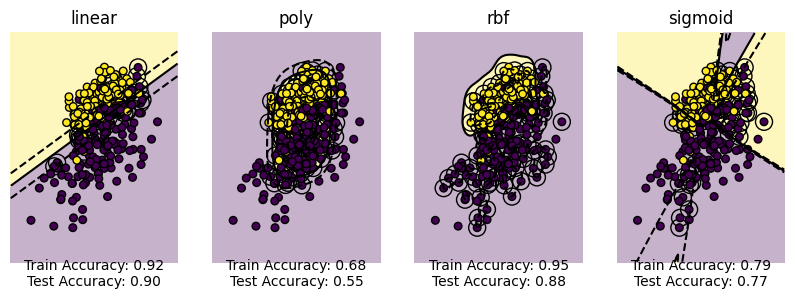

Degree: 4, Gamma: 50


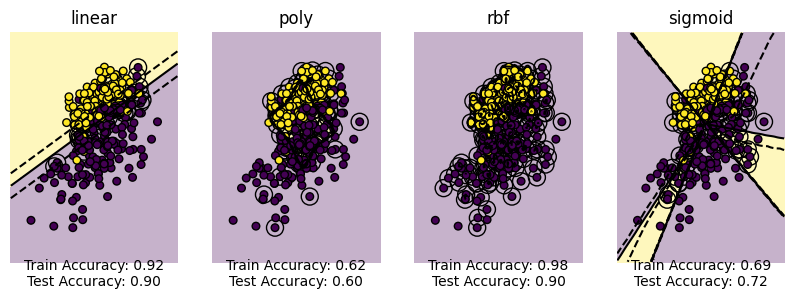

In [7]:
# Examine effect of degree and gamma keyword for the linearly separable dataset
for degree in [1, 2, 3, 4]:
    for gamma in [0.1, 1, 5, 50]:
        print(f"Degree: {degree}, Gamma: {gamma}")
        X, y = generate_dataset('linearly_separable')
        kernel_comparison(X, y, support_vectors=True, tight_box=False, if_flag=True, degree=degree, gamma=gamma)
        plt.show()

Degree: 1, Gamma: 0.1


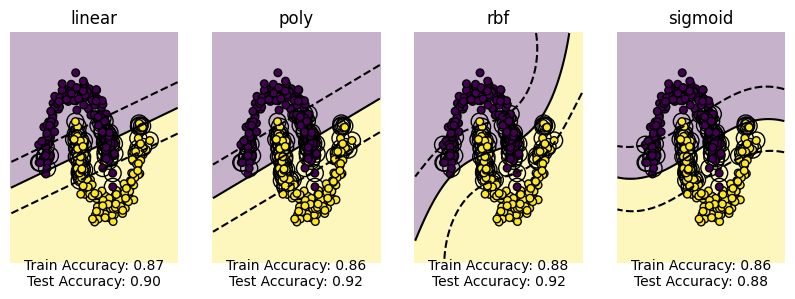

Degree: 1, Gamma: 1


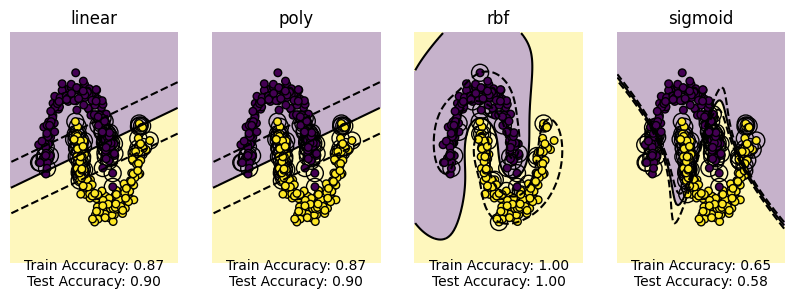

Degree: 1, Gamma: 5


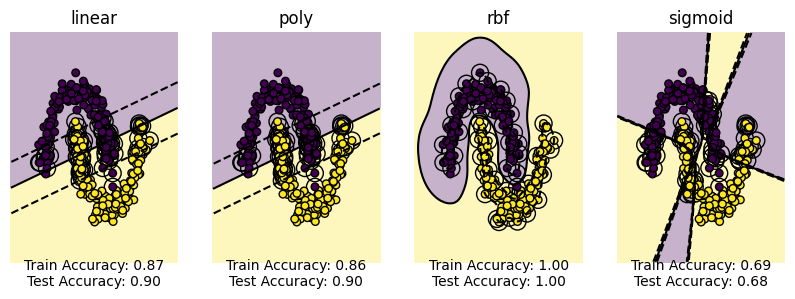

Degree: 1, Gamma: 50


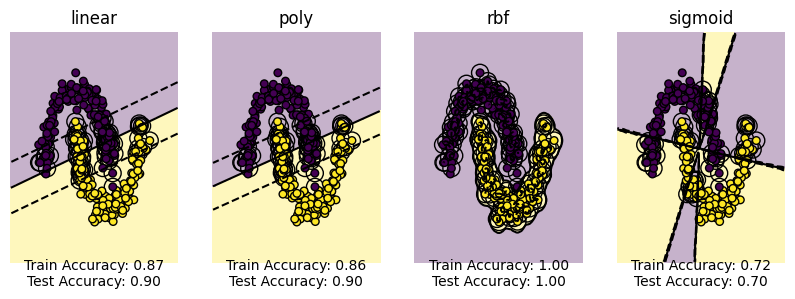

Degree: 2, Gamma: 0.1


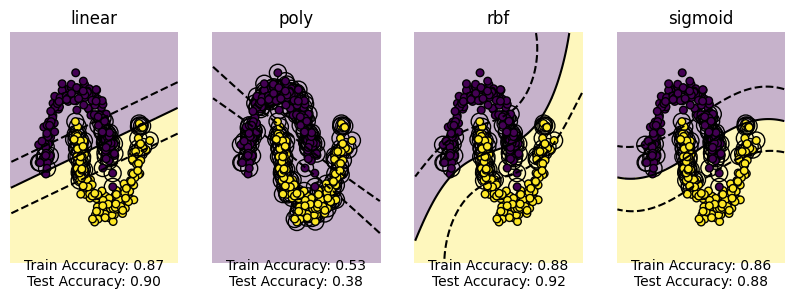

Degree: 2, Gamma: 1


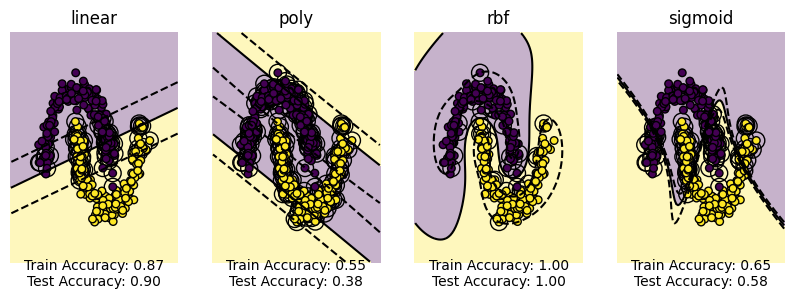

Degree: 2, Gamma: 5


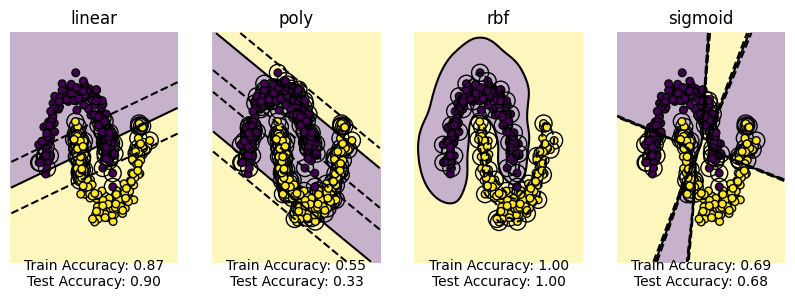

Degree: 2, Gamma: 50


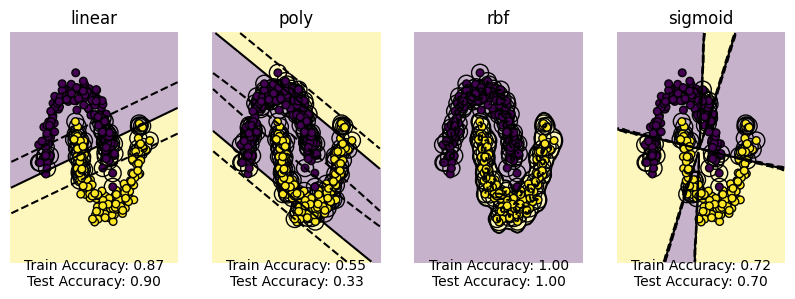

Degree: 3, Gamma: 0.1


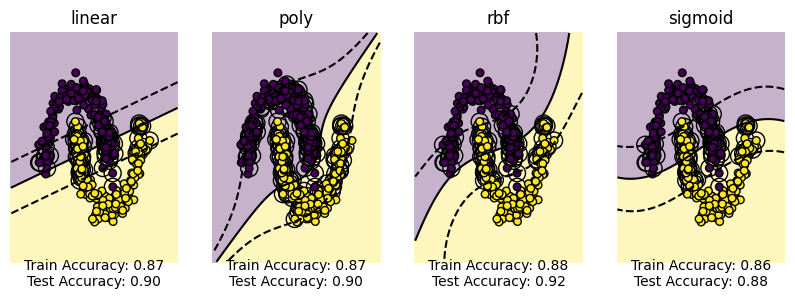

Degree: 3, Gamma: 1


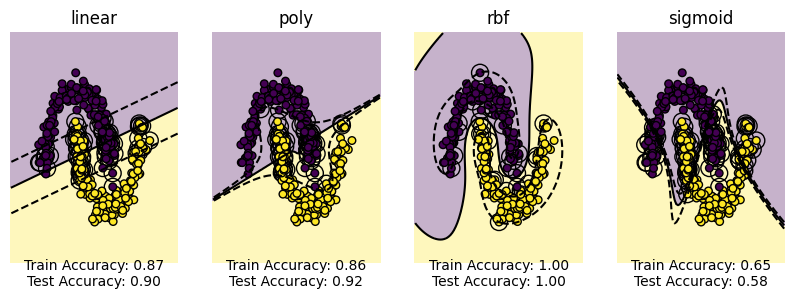

Degree: 3, Gamma: 5


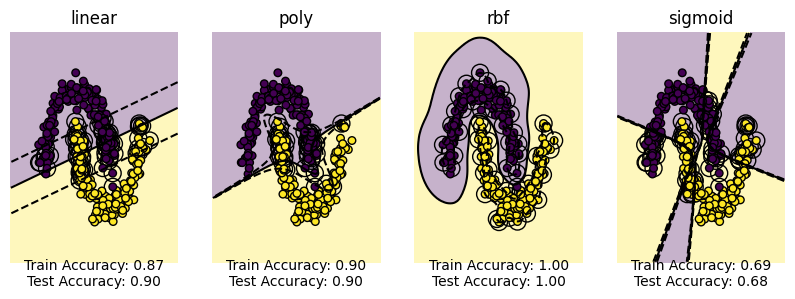

Degree: 3, Gamma: 50


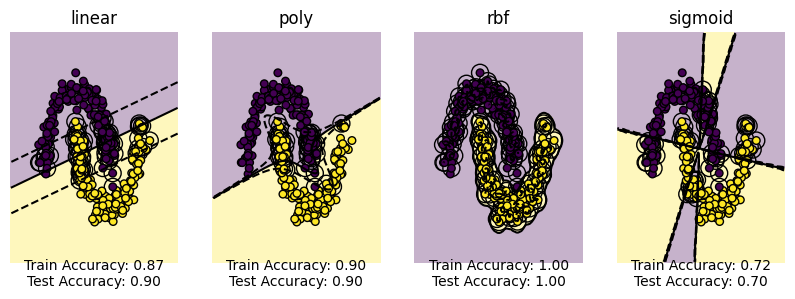

Degree: 4, Gamma: 0.1


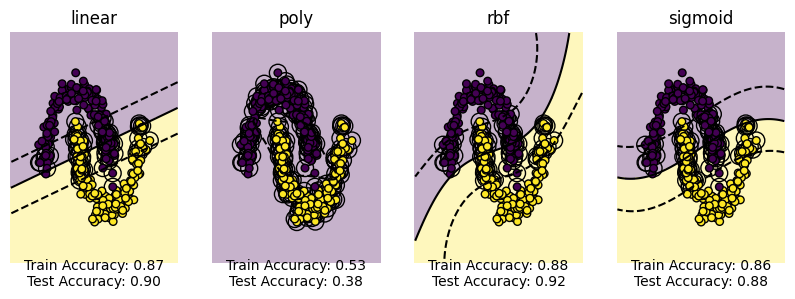

Degree: 4, Gamma: 1


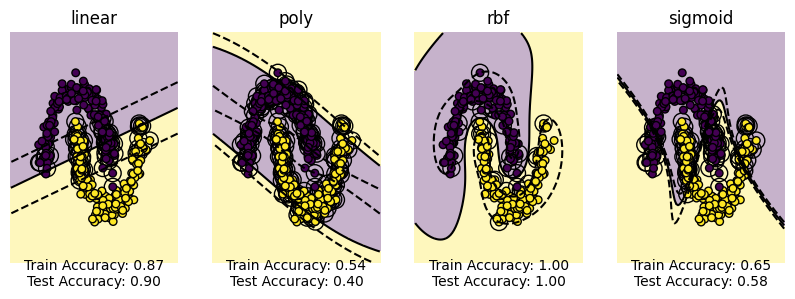

Degree: 4, Gamma: 5


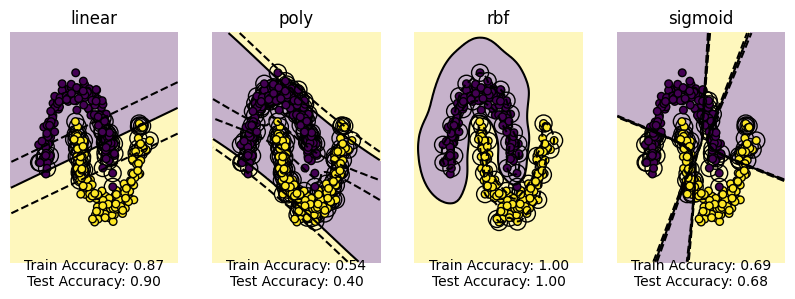

Degree: 4, Gamma: 50


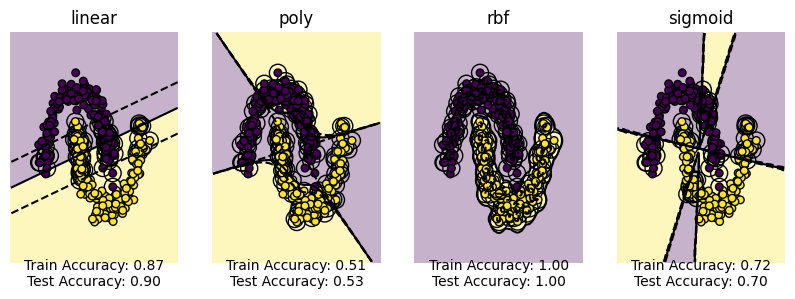

In [8]:
# Examine effect of degree and gamma keyword for the moons dataset
for degree in [1, 2, 3, 4]:
    for gamma in [0.1, 1, 5, 50]:
        print(f"Degree: {degree}, Gamma: {gamma}")
        X, y = generate_dataset('moons', noise=0.1)
        kernel_comparison(X, y, support_vectors=True, tight_box=False, if_flag=True, degree=degree, gamma=gamma)
        plt.show()

Degree: 1, Gamma: 0.1
0
1


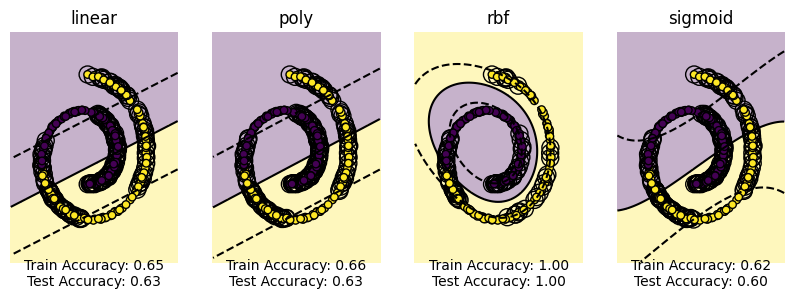

Degree: 1, Gamma: 1
0
1


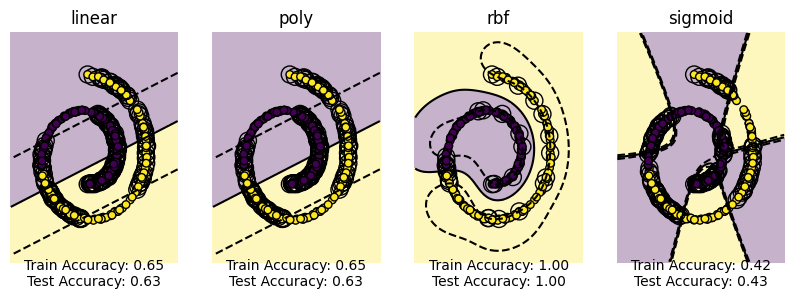

Degree: 1, Gamma: 5
0
1


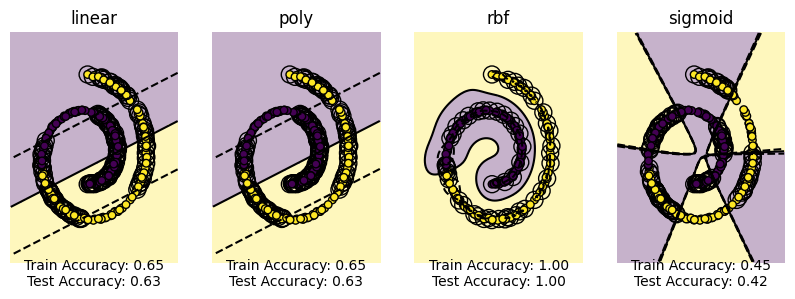

Degree: 1, Gamma: 50
0
1


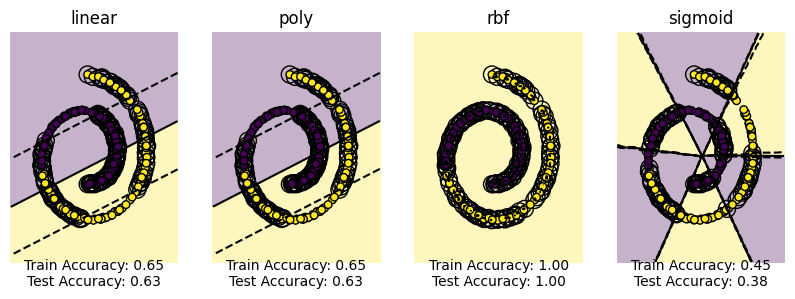

Degree: 2, Gamma: 0.1
0
1


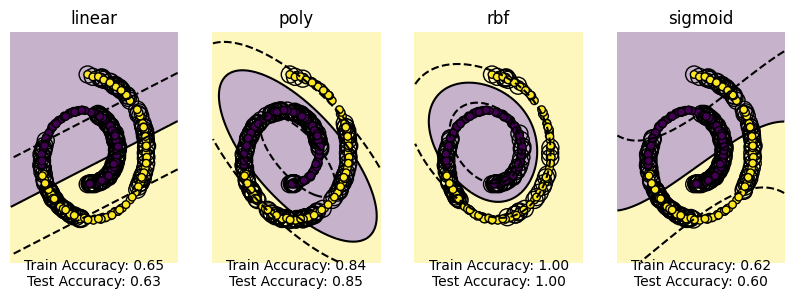

Degree: 2, Gamma: 1
0
1


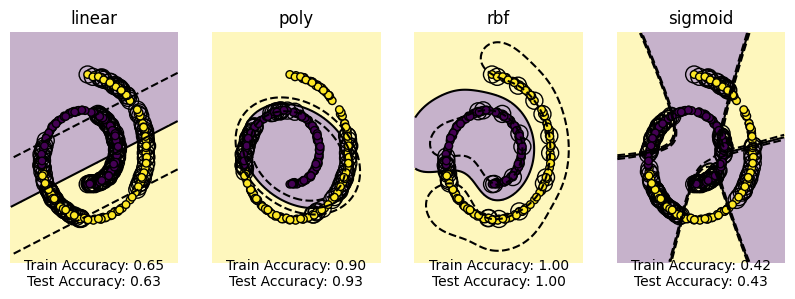

Degree: 2, Gamma: 5
0
1


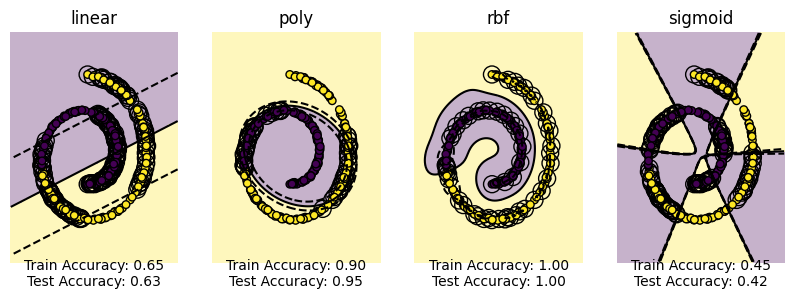

Degree: 2, Gamma: 50
0
1


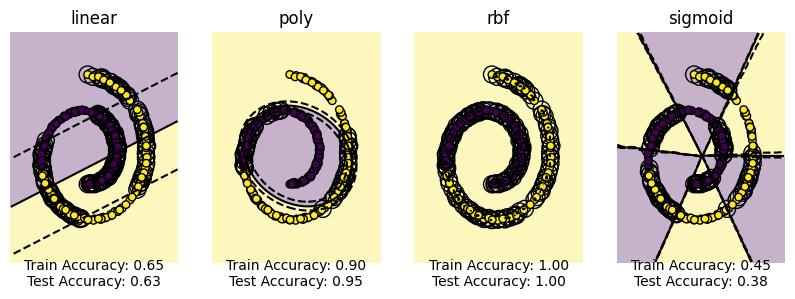

Degree: 3, Gamma: 0.1
0
1


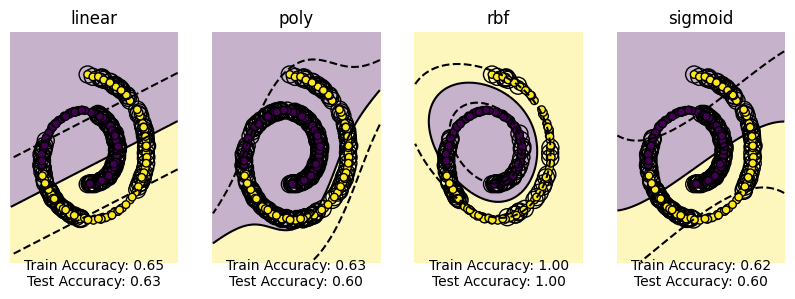

Degree: 3, Gamma: 1
0
1


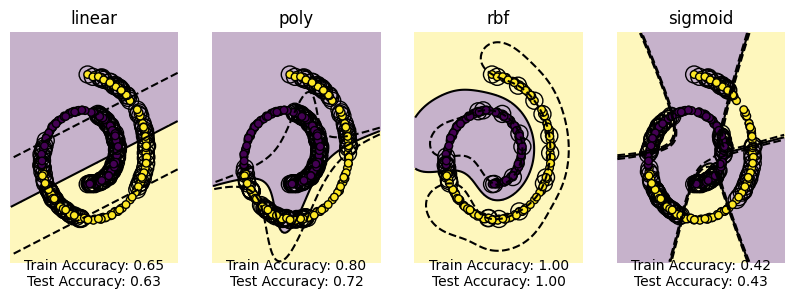

Degree: 3, Gamma: 5
0
1


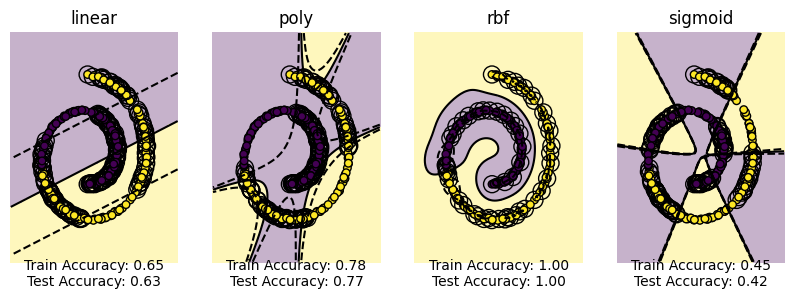

Degree: 3, Gamma: 50
0
1


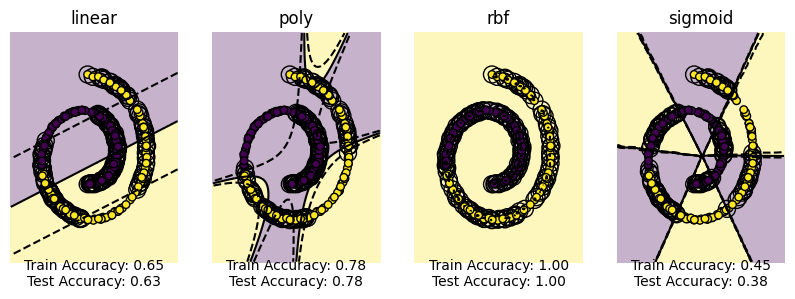

Degree: 4, Gamma: 0.1
0
1


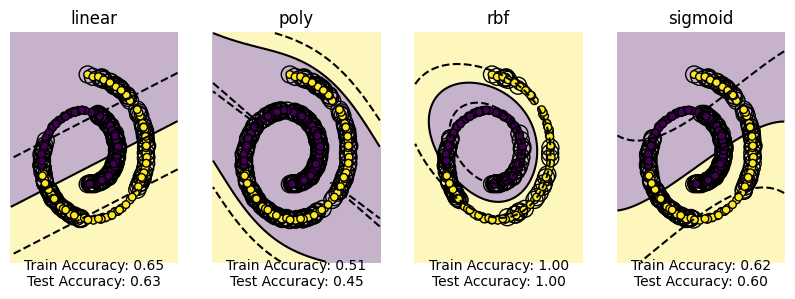

Degree: 4, Gamma: 1
0
1


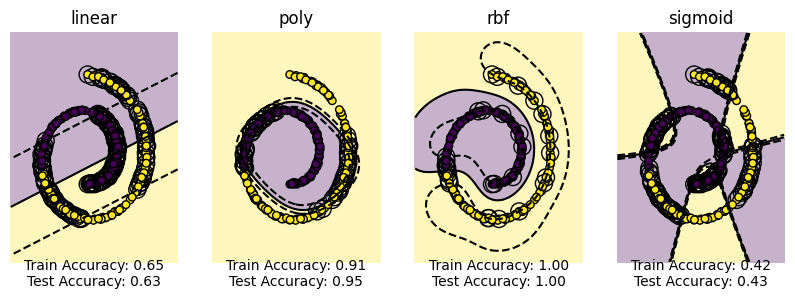

Degree: 4, Gamma: 5
0
1


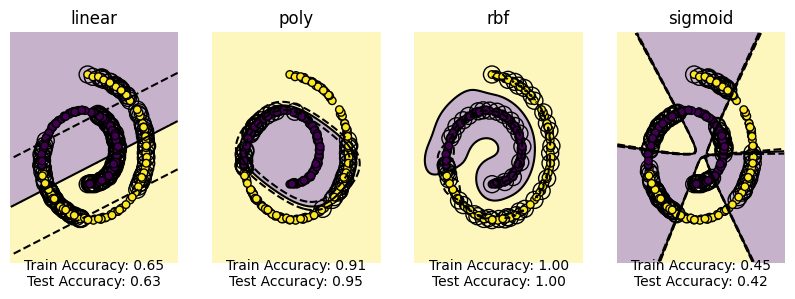

Degree: 4, Gamma: 50
0
1


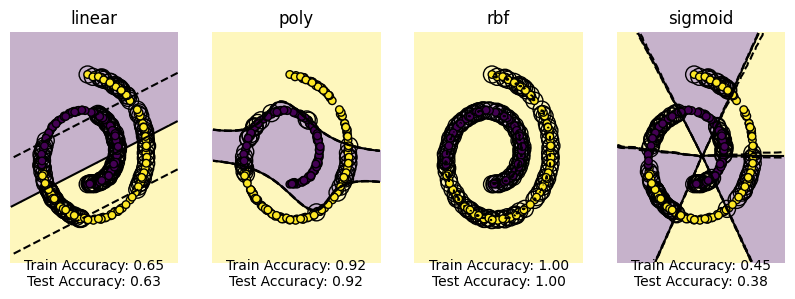

In [9]:
# Examine effect of degree and gamma keyword for the swiss dataset with 2 splits
for degree in [1, 2, 3, 4]:
    for gamma in [0.1, 1, 5, 50]:
        print(f"Degree: {degree}, Gamma: {gamma}")
        X, y = generate_dataset('swiss', noise=0.1, split=2)
        kernel_comparison(X, y, support_vectors=True, tight_box=False, if_flag=True, degree=degree, gamma=gamma)
        plt.show()

Degree: 1, Gamma: 0.1
0
1


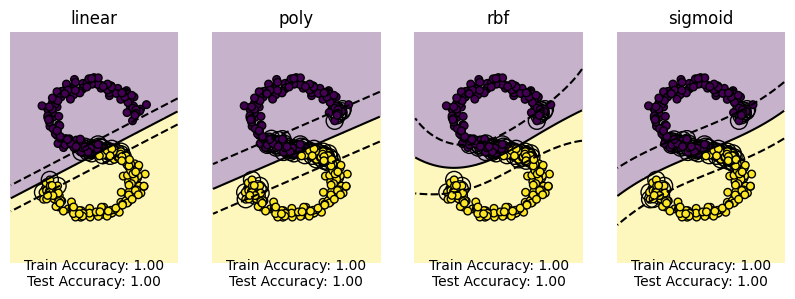

Degree: 1, Gamma: 1
0
1


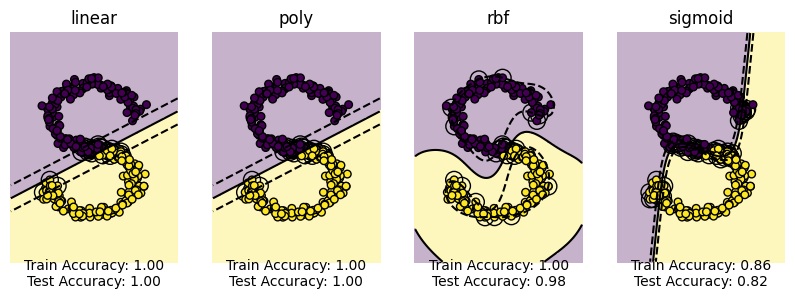

Degree: 1, Gamma: 5
0
1


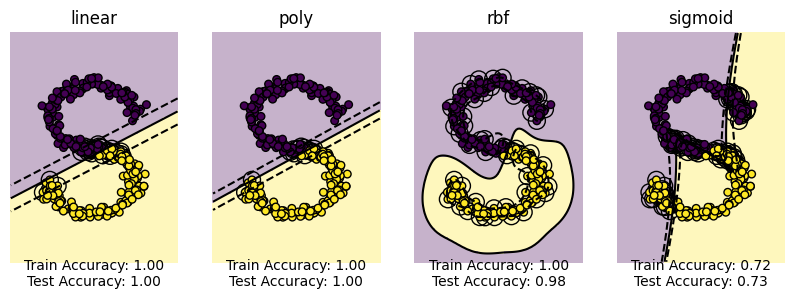

Degree: 1, Gamma: 50
0
1


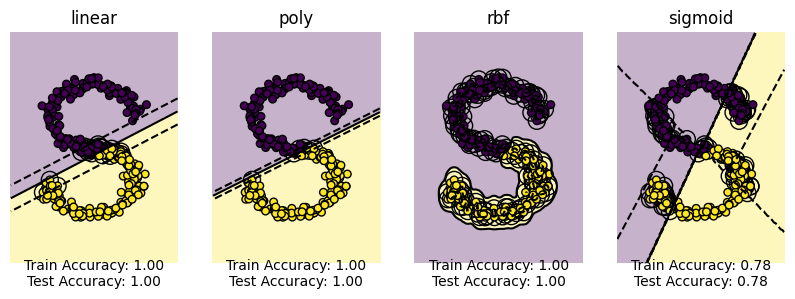

Degree: 2, Gamma: 0.1
0
1


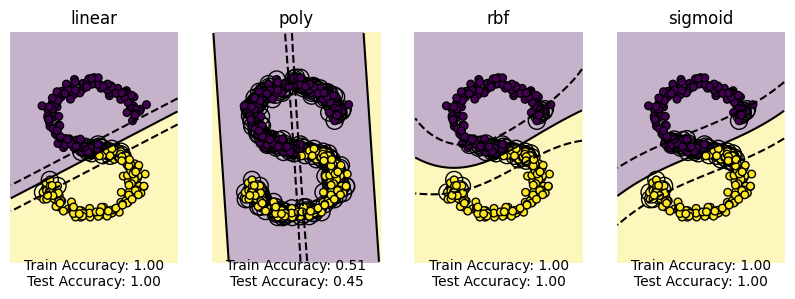

Degree: 2, Gamma: 1
0
1


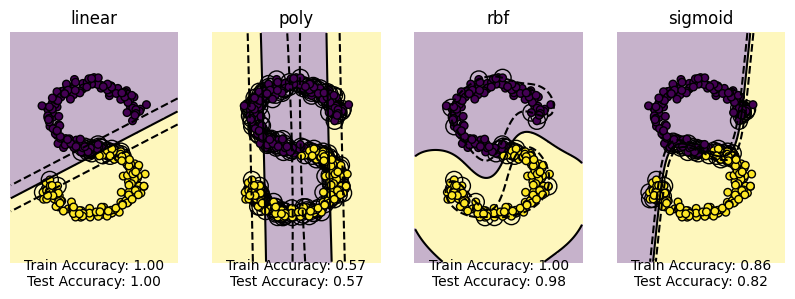

Degree: 2, Gamma: 5
0
1


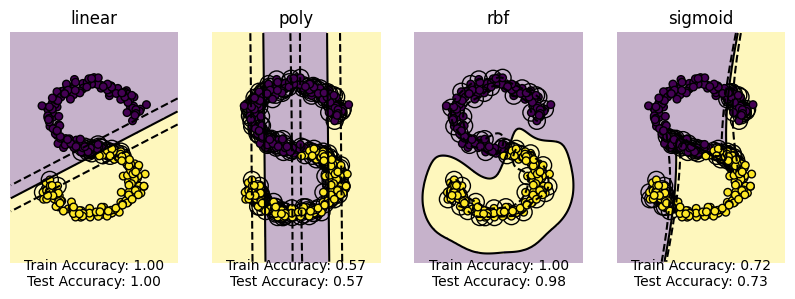

Degree: 2, Gamma: 50
0
1


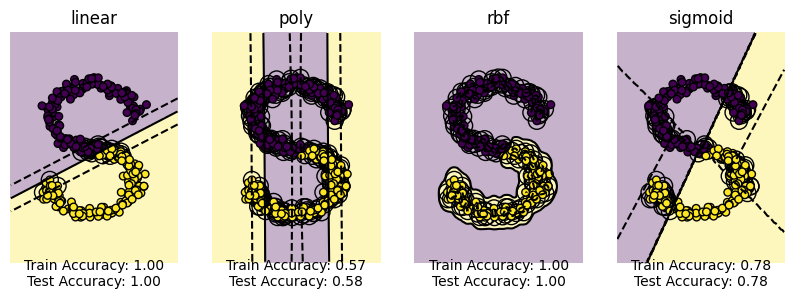

Degree: 3, Gamma: 0.1
0
1


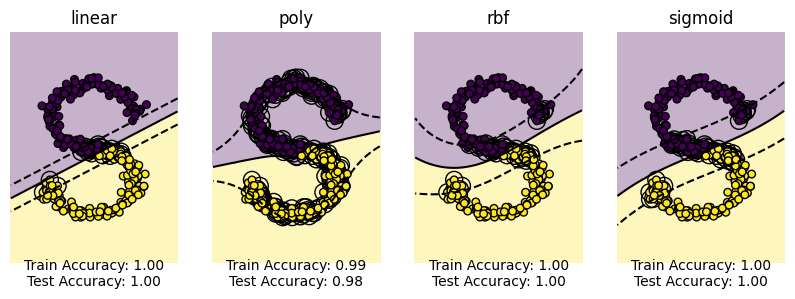

Degree: 3, Gamma: 1
0
1


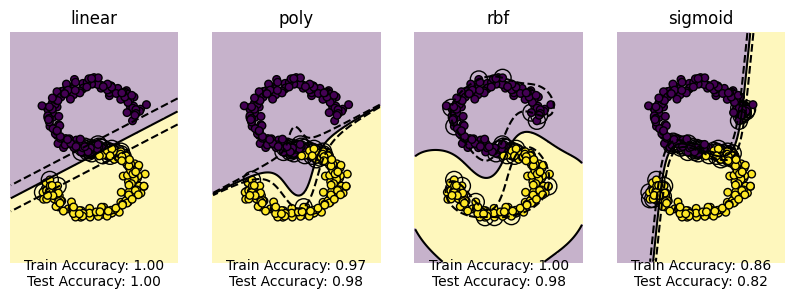

Degree: 3, Gamma: 5
0
1


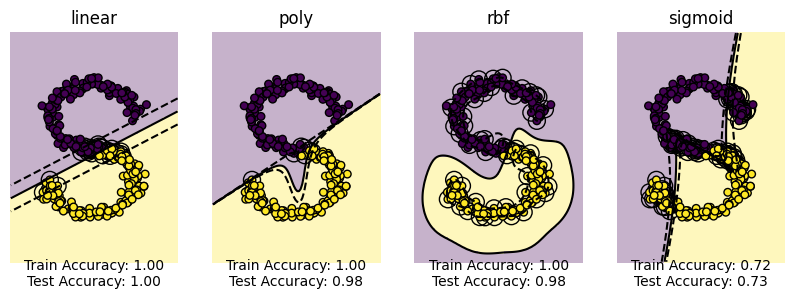

Degree: 3, Gamma: 50
0
1


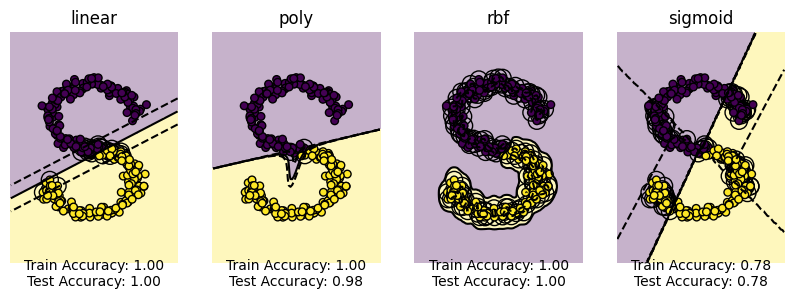

Degree: 4, Gamma: 0.1
0
1


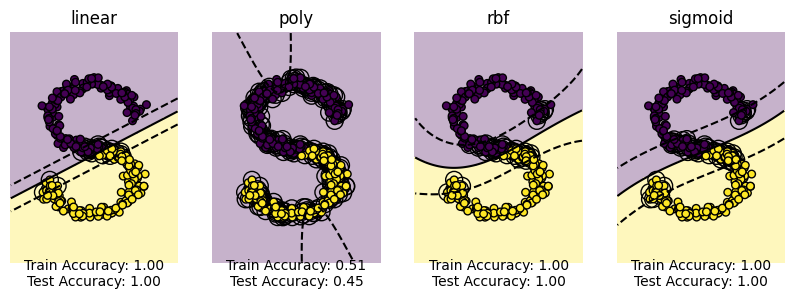

Degree: 4, Gamma: 1
0
1


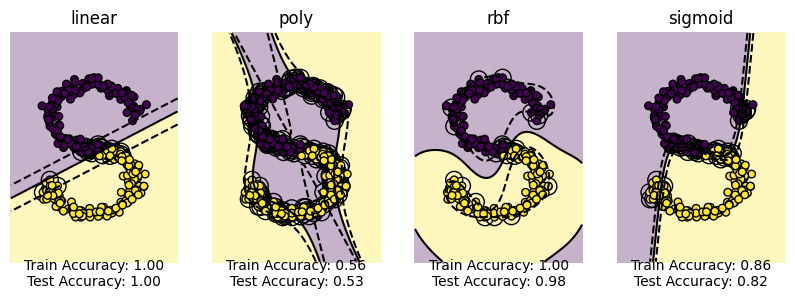

Degree: 4, Gamma: 5
0
1


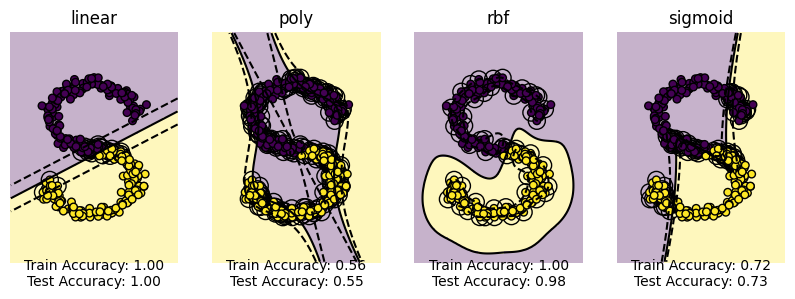

Degree: 4, Gamma: 50
0
1


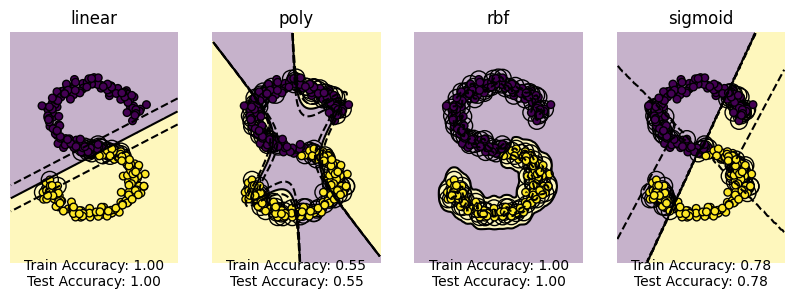

In [10]:
# Examine effect of degree and gamma keyword for the scurve dataset with 2 splits
for degree in [1, 2, 3, 4]:
    for gamma in [0.1, 1, 5, 50]:
        print(f"Degree: {degree}, Gamma: {gamma}")
        X, y = generate_dataset('scurve', noise=0.1, split=2)
        kernel_comparison(X, y, support_vectors=True, tight_box=False, if_flag=True, degree=degree, gamma=gamma)
        plt.show()

Degree: 1, Gamma: 0.1
0
1
2
3
4
5
6
7
8
9


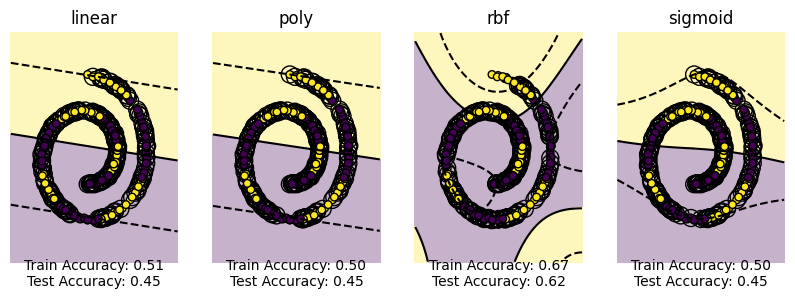

Degree: 1, Gamma: 1
0
1
2
3
4
5
6
7
8
9


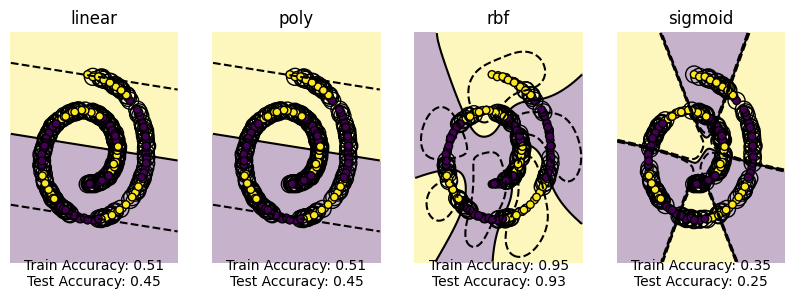

Degree: 1, Gamma: 5
0
1
2
3
4
5
6
7
8
9


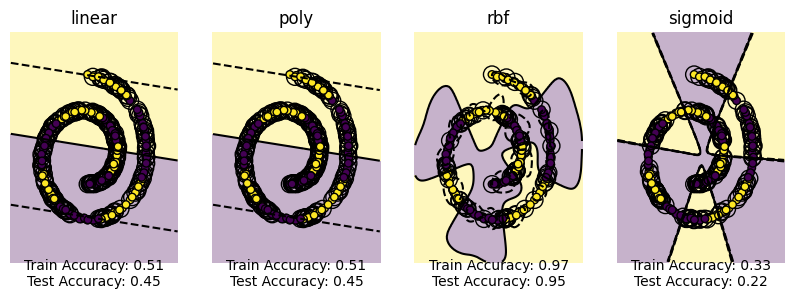

Degree: 1, Gamma: 50
0
1
2
3
4
5
6
7
8
9


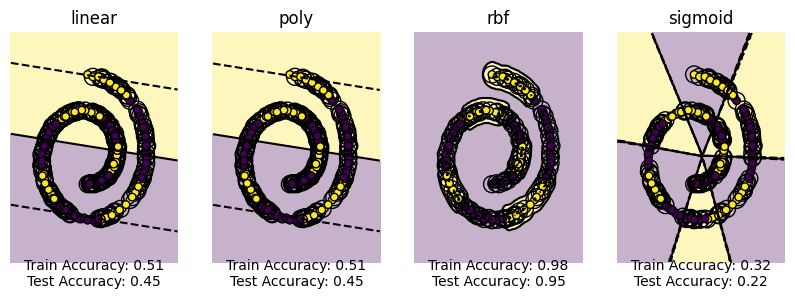

Degree: 2, Gamma: 0.1
0
1
2
3
4
5
6
7
8
9


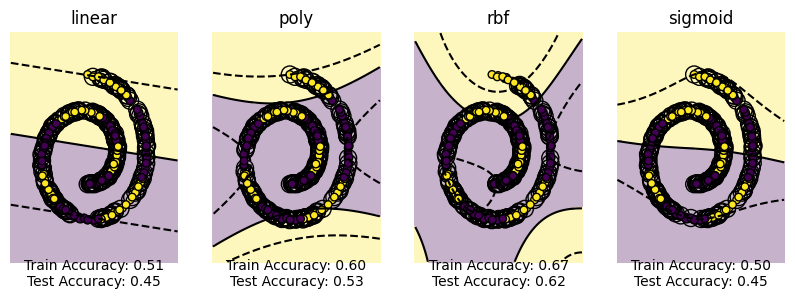

Degree: 2, Gamma: 1
0
1
2
3
4
5
6
7
8
9


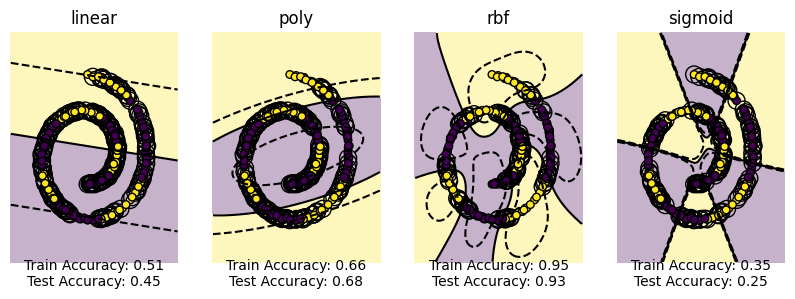

Degree: 2, Gamma: 5
0
1
2
3
4
5
6
7
8
9


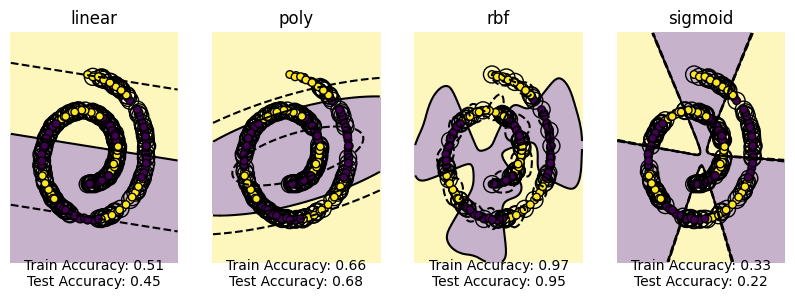

Degree: 2, Gamma: 50
0
1
2
3
4
5
6
7
8
9


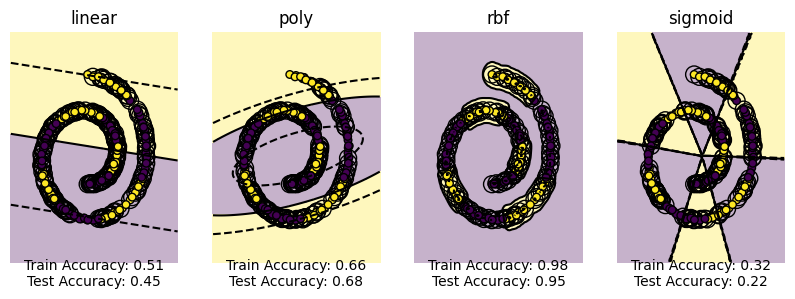

Degree: 3, Gamma: 0.1
0
1
2
3
4
5
6
7
8
9


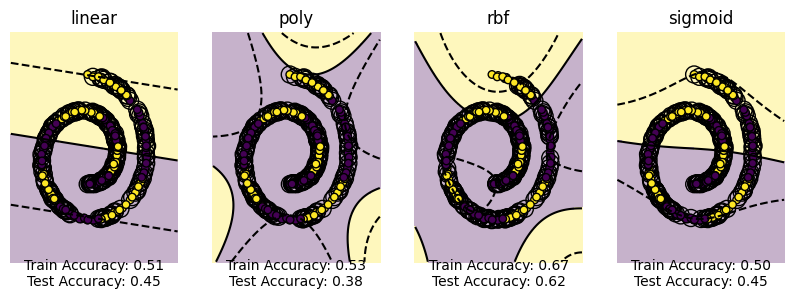

Degree: 3, Gamma: 1
0
1
2
3
4
5
6
7
8
9


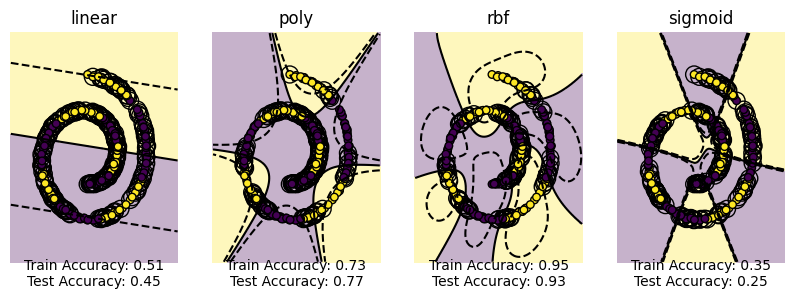

Degree: 3, Gamma: 5
0
1
2
3
4
5
6
7
8
9


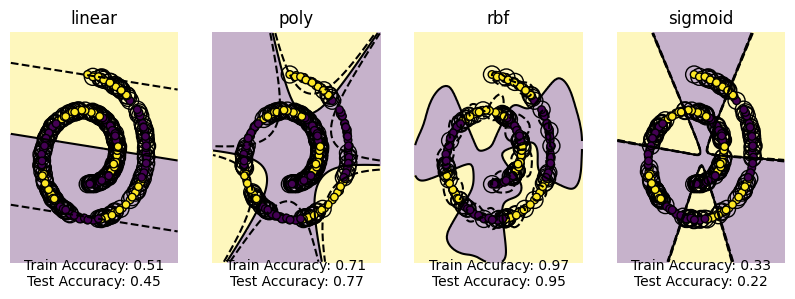

Degree: 3, Gamma: 50
0
1
2
3
4
5
6
7
8
9


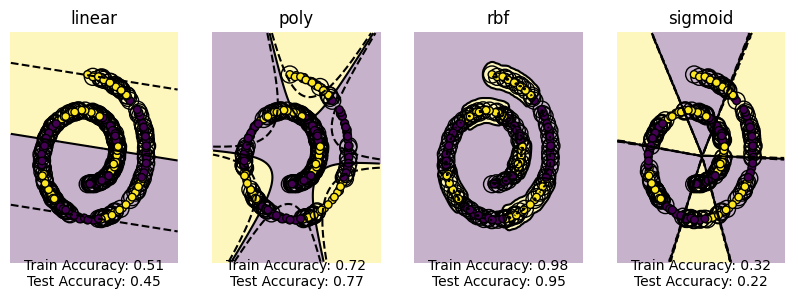

Degree: 4, Gamma: 0.1
0
1
2
3
4
5
6
7
8
9


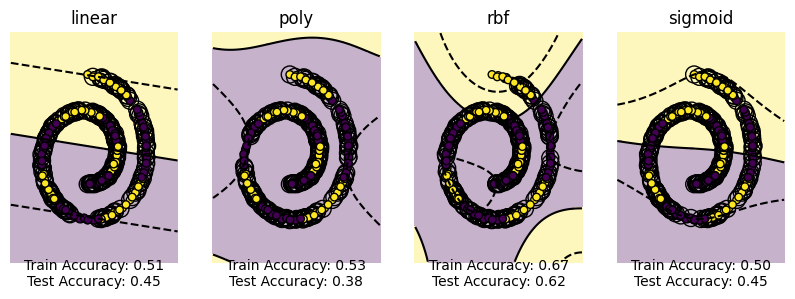

Degree: 4, Gamma: 1
0
1
2
3
4
5
6
7
8
9


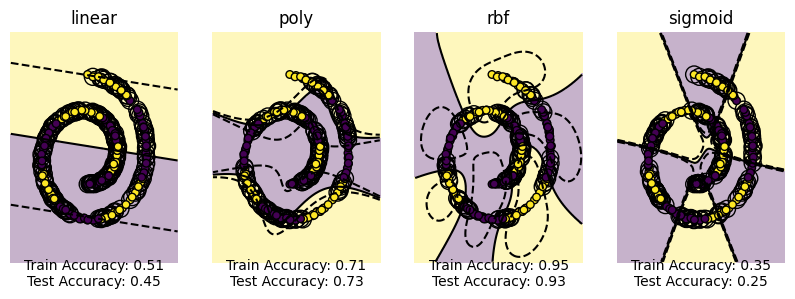

Degree: 4, Gamma: 5
0
1
2
3
4
5
6
7
8
9


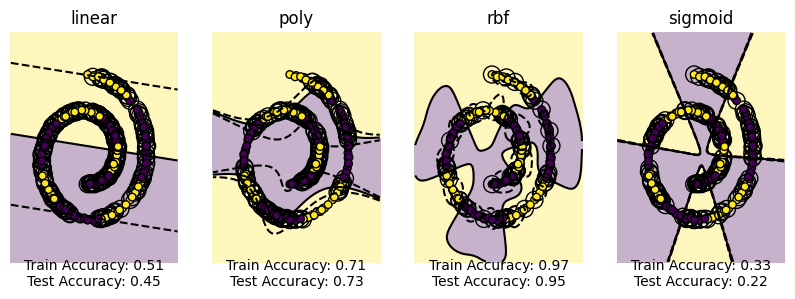

Degree: 4, Gamma: 50
0
1
2
3
4
5
6
7
8
9


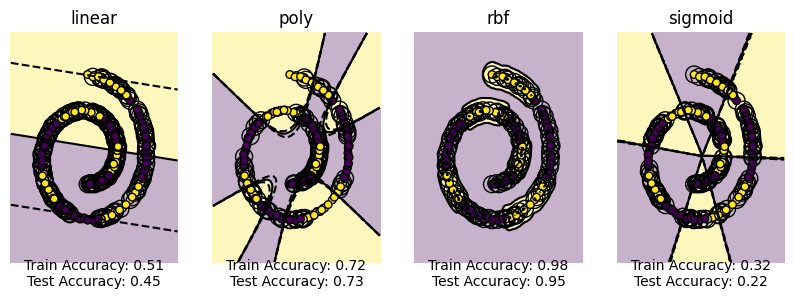

In [11]:
# Examine effect of degree and gamma keyword for the swiss dataset with 10 splits
for degree in [1, 2, 3, 4]:
    for gamma in [0.1, 1, 5, 50]:
        print(f"Degree: {degree}, Gamma: {gamma}")
        X, y = generate_dataset('swiss', noise=0.1, split=10)
        kernel_comparison(X, y, support_vectors=True, tight_box=False, if_flag=True, degree=degree, gamma=gamma)
        plt.show()

Degree: 1, Gamma: 0.1
0
1
2
3
4
5
6
7
8
9


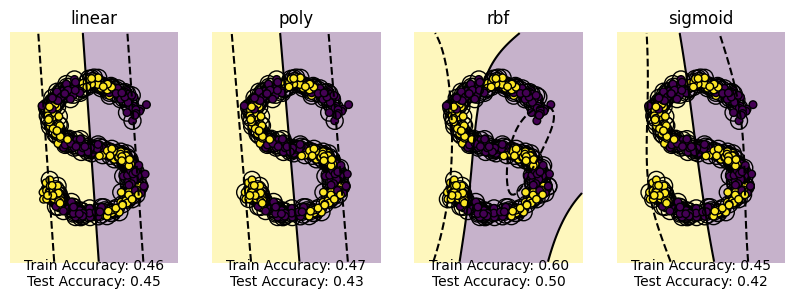

Degree: 1, Gamma: 1
0
1
2
3
4
5
6
7
8
9


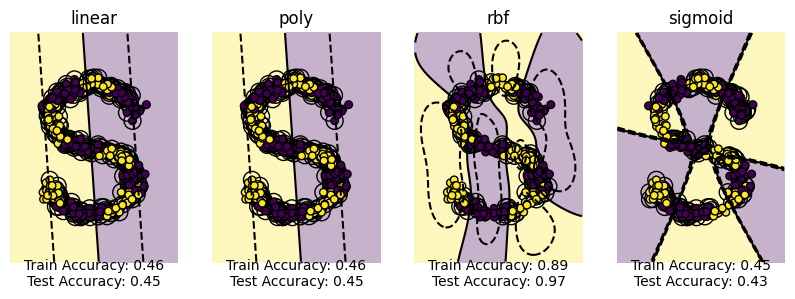

Degree: 1, Gamma: 5
0
1
2
3
4
5
6
7
8
9


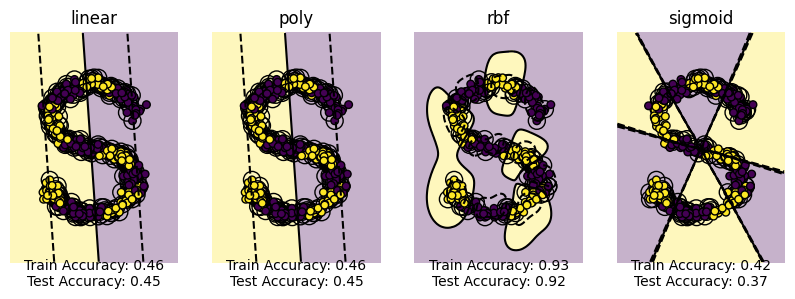

Degree: 1, Gamma: 50
0
1
2
3
4
5
6
7
8
9


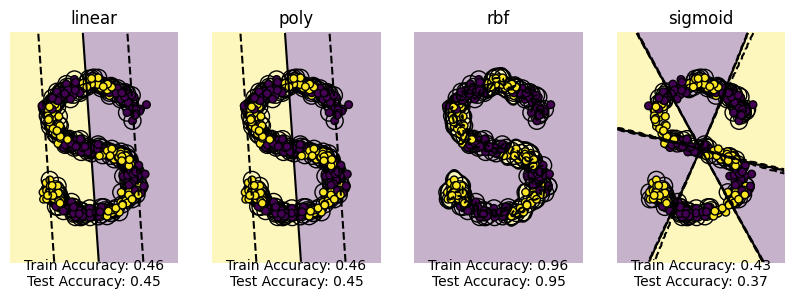

Degree: 2, Gamma: 0.1
0
1
2
3
4
5
6
7
8
9


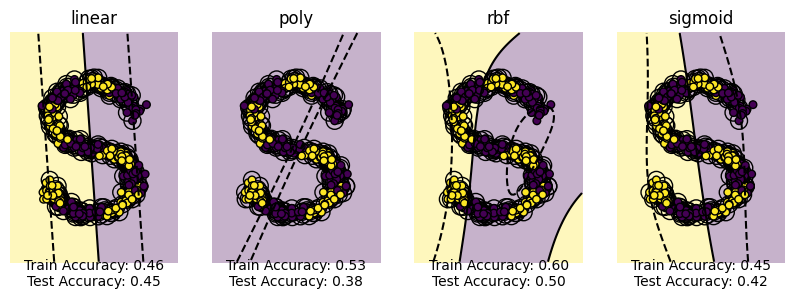

Degree: 2, Gamma: 1
0
1
2
3
4
5
6
7
8
9


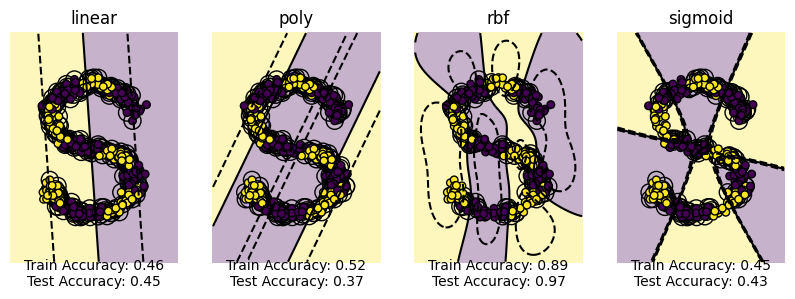

Degree: 2, Gamma: 5
0
1
2
3
4
5
6
7
8
9


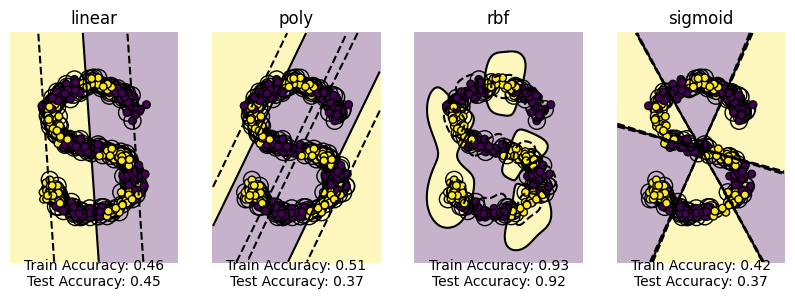

Degree: 2, Gamma: 50
0
1
2
3
4
5
6
7
8
9


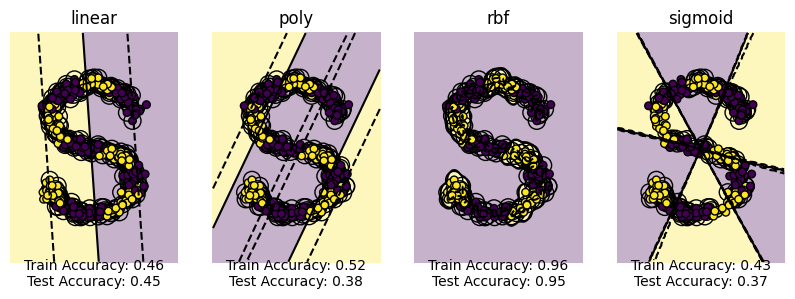

Degree: 3, Gamma: 0.1
0
1
2
3
4
5
6
7
8
9


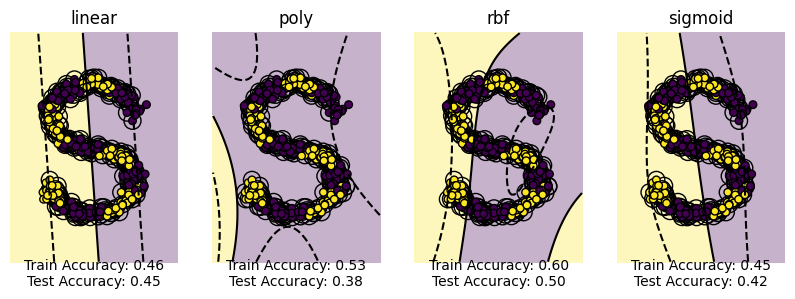

Degree: 3, Gamma: 1
0
1
2
3
4
5
6
7
8
9


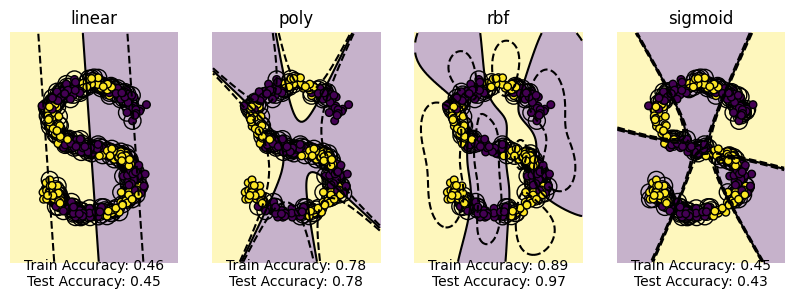

Degree: 3, Gamma: 5
0
1
2
3
4
5
6
7
8
9


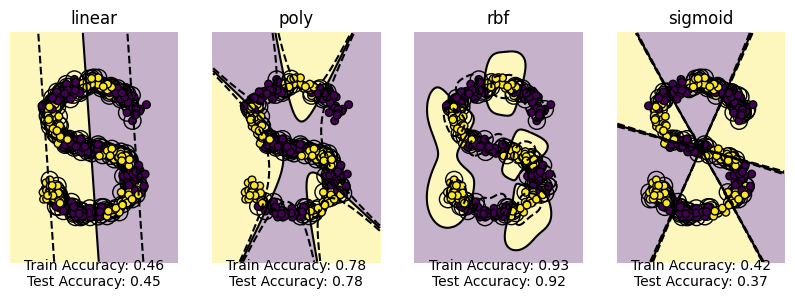

Degree: 3, Gamma: 50
0
1
2
3
4
5
6
7
8
9


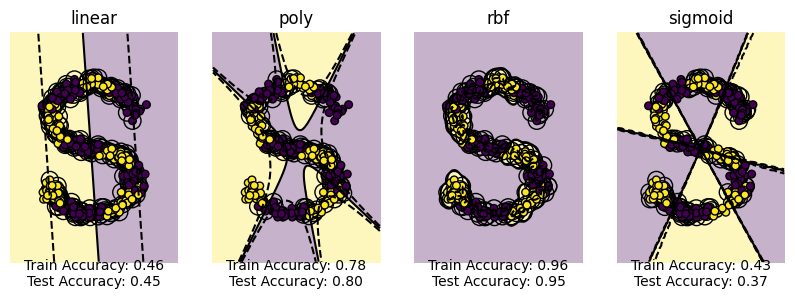

Degree: 4, Gamma: 0.1
0
1
2
3
4
5
6
7
8
9


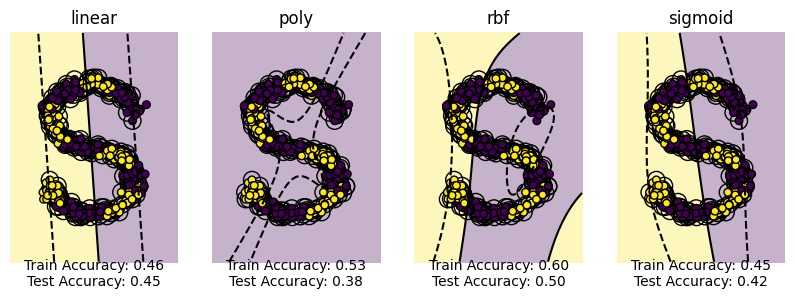

Degree: 4, Gamma: 1
0
1
2
3
4
5
6
7
8
9


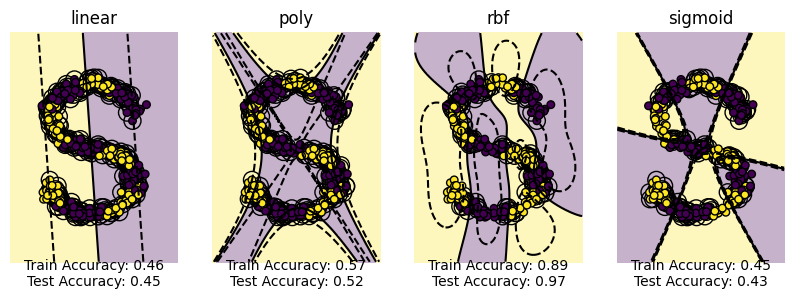

Degree: 4, Gamma: 5
0
1
2
3
4
5
6
7
8
9


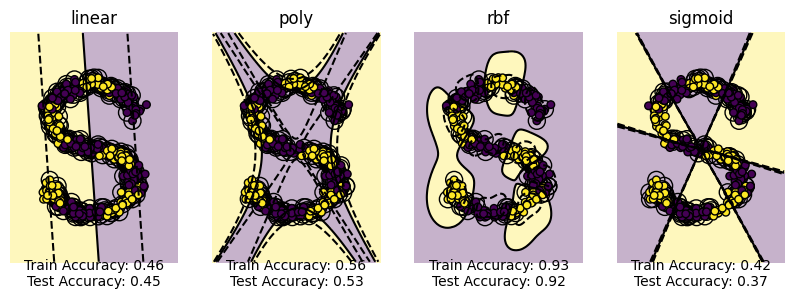

Degree: 4, Gamma: 50
0
1
2
3
4
5
6
7
8
9


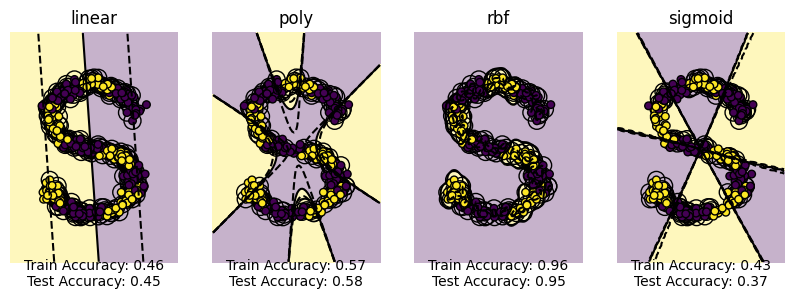

In [12]:
# Examine effect of degree and gamma keyword for the scurve dataset with 10 splits
for degree in [1, 2, 3, 4]:
    for gamma in [0.1, 1, 5, 50]:
        print(f"Degree: {degree}, Gamma: {gamma}")
        X, y = generate_dataset('scurve', noise=0.1, split=10)
        kernel_comparison(X, y, support_vectors=True, tight_box=False, if_flag=True, degree=degree, gamma=gamma)
        plt.show()

The `degree` argument affects [BLOBS]. It changes the model by [mostly affecting the poly kernel. It affects the degree of the polynomial used to approximate the data. This causes the biggest difference between odd and even. Often the model becomes more spread out in its fit]. This affects the model's bias-variance tradeoff by [increasing the decreasing the variance but increasing the bias]. 

As one increases the `degree`, the decision boundary [becomes less linear for even degrees, an often vastly favors one of the predictions]. 

The `gamma` argument affects [BLOBS]. It changes the model by [mostly affecting the poly kernel. As gamma increases, the rbf model tends to start favoring one of the predictions]. This affects the model's bias-variance tradeoff by [increasing the variance while decreasing the bias, because the model becomes very personalized to the given training data]. 

As one increases `gamma`, the decision boundary of [the rbf model shrinks around the purple points]. 


The `degree` argument affects [unstructured]. It changes the model by [seemingly fluctuating whether the models will try to find a descernable pattenr in the data, or just pick one prediction and stick with it]. This affects the model's bias-variance tradeoff by [fluctuating between high bias and medium bias]. 

As one increases the `degree`, the decision boundary [will change but with no discernable pattern]. 

The `gamma` argument affects [unstructured]. It affects the rbf kernel by essentially increasing the fine-grain partitions of the data into discrete decision areas. This affects the model's bias-variance tradeoff by [increasing the variance but decreasing the bias].  It also affects the other kernels by seemingly fluctuating their bias-variance tradeoff, but it is not in a clearly discernable pattern.

As one increases `gamma`, the decision boundary of [the rbf kernel seems to get smaller and smaller blobs until there are no blobs and the model just picks one of the predictions to go with for all of them].


The `degree` argument affects [circles]. It changes the model by [vastly affecting how the ability of the poly kernel to predict the data. Specifically, the even models were able to capture the pattern, but the odd models just chose one prediction outcome]. This affects the model's bias-variance tradeoff by [making it very biased in the case of odd degrees, but only medium biased in the case of even degrees, and slight variance]. 

As one increases the `degree`, the decision boundary [would fluctuate from being non-existent to being existent]. 

The `gamma` argument affects [circles]. It changes the model by [increasing the test performance of the sigmoid model]. This affects the model's bias-variance tradeoff by [increasing it's bias, but decreasing variance]. 

As one increases `gamma`, the decision boundary of [rbf kernel was affected in a similar way to the unstructured data, where the number of decision areas increased, while the size of each one decreased. The opposite seemed to be true for the sigmoid kernel]. 


Very similar behavior was exhibited for the [quantiles] data as the circles data.

The `degree` argument affects [linearly seperable]. It changes the model by [fluctuating the ability of the poly kernel to capture the patterns in data based on whether the degree was odd or even. This time even degrees were worse. Interestingly, degree 1 was the best, and even degree 3 was better than even degrees, but worse than 1]. This affects the model's bias-variance tradeoff by [generally increasing variance with an increase in degree, although not significantly]. 

As one increases the `degree`, the decision boundary [would fluctuate from being circular or more "linear"]. 

The `gamma` argument affects [linearly seperable]. It changes the model by [increasing the test score while not changing the test score for the rbf model]. This affects the model's bias-variance tradeoff by [increasing variance]. For the sigmoid model, the opposite was true. The train score decreased, while the test score stayed the same, signifying a reduction in variance and an increase in bias.

As one increases `gamma`, the decision boundary of [the rbf kernel and sigmoid kernel in much the same ways as above]. 


The `degree` argument affects [moons]. It changes the model by [affecting the poly kernel in much the same way as the linearly seperable data]. Interestingly though, degree 1 and 3 were roughly the same this time.

The `gamma` argument affects [moons]. It changes the model in the same manner as linearly seperable.


[Swiss]: same general pattern as others. This time even degrees were good for capturing the pattern for the poly kernel. The rbf kernel was really good at capturing this pattern. The gamma value increased the accuracy of the rbf and poly models in both training and testing.


[s-curve]: same general patterns. This time odd degrees are good for the poly kernel. RBF is once again very successful at capturing this pattern. The gamma value negatively affected the sigmoid kernel, while positively affectign the rbf kernel.

For the swiss and s-curve datasets with 10 splits, the only kernel that was successful with capturing the pattern was the rbf kernel.

**Summary:** The linear kernel was unnafected by degree and gamma. Degree mostly affected the poly kernel with major differences between odd and even degrees. Usually one of them was the right choice for the given data. Gamma would usually affect the rbf kernel by either increasing its variance or just making it more accurate. Gamma would also usually affect the sigmoid kernel by decreasing its variance, but usually not improving performance.

## Part 2: US Flags

### Part 2.1: Load and explore flags data
The function `load_images` loads the image data from the flags folder and turns each image into a binary (i.e., black and white) array.

1. Load the flags data.
2. Display four flags of your choice in a figure. Use the `matplotlib` commands `subplot` and `imshow` to create a figure with 2x2 flags. Consult the `matplotlib` documentation to find a way set the aspect ratio of your displayed flags to match their original aspect ratio. Update your code accordingly.

In [4]:
def load_images(folder):
    images = []
    labels = []
    for filename in os.listdir(folder):
        if filename.endswith(".png"):
            img_path = os.path.join(folder, filename)
            img = Image.open(img_path).convert('L')  # Convert image to black and white
            img = np.array(img)//(256/2) # Convert to BW
            images.append(img)
            labels.append(filename.split('.')[0])  # Extract the state code as label
    return images, labels

/Users/joshuapiesner/Documents/GitHub/mathematics-and-ai/.venv/lib/python3.12/site-packages/PIL/Image.py:1056: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


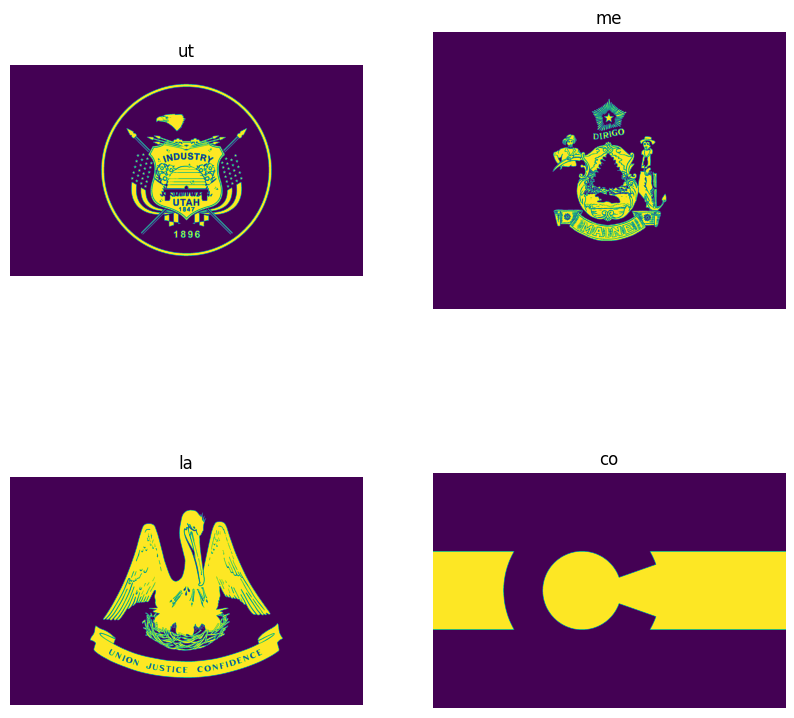

In [5]:
# Display four black-and-white flags in a 2x2 grid
'''ADD SOME CODE HERE'''
images, labels = load_images('flags')
fig, axs = plt.subplots(
    2, 
    2, 
    figsize=(10, 10),
)
for i, ax in enumerate(axs.flat):
    ax.imshow(images[i], cmap='viridis', aspect='equal')
    ax.axis('off')
    ax.set_title(labels[i])
plt.show()


### Part 2.2: SVMs for flag pixel data
The function `sample_pixels` samples a pixel from a given image uniformly at random. 

1. Use the `sample_pixels`  function to generate synthetic data sets of pixels from for a flag image.
2. Update the `kernel_comparison` function so that if `if_flag` is `True` the decision boundaries are plotted in a 2x2 grid of subplots with plot ranges matching the height and width of the flags.
3. Show the results of the kernel comparison for the four flags that your previously selected. Use the highest values of `degree` and `gamma` that still run *reasonably fast* on your laptop.
4. Adjust your code so that you can run the quantitative part (i.e., the calculation of train and test accuracy) without plotting the decision boundaries. Run the adjusted code on all flags to indentify for each kernel the flags that yield to best easiest-to-classify and hardest-to-classify data sets. Test how the number of of pixels sampled affects your results.

In [6]:
def sample_pixels(image, num_samples=100):
    pixel_data = []
    pixel_labels = []
    height, width = image.shape
    for _ in range(num_samples):
        x1 = random.randint(0, width - 1)
        x2 = random.randint(0, height - 1)
        pixel_data.append([x1/width-0.5, x2/width-0.5])
        pixel_labels.append(image[x2,x1])
    return np.array(pixel_data), np.array(pixel_labels, dtype=int)

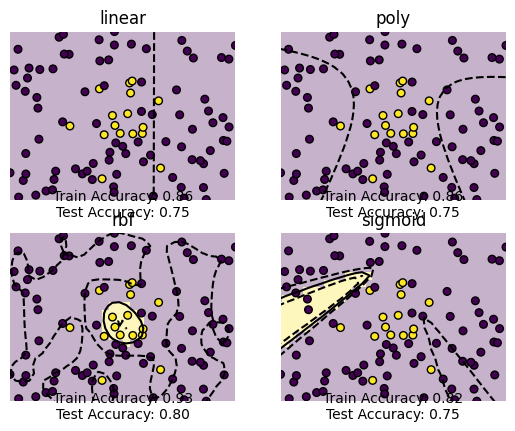

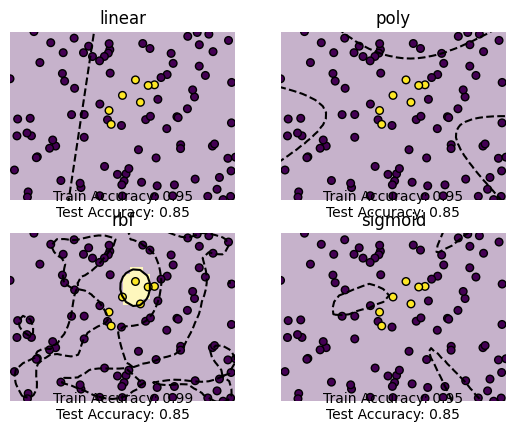

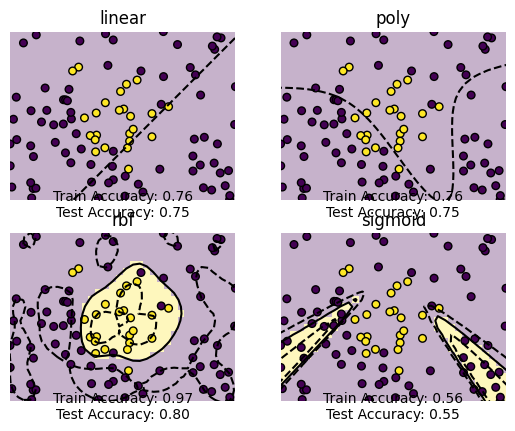

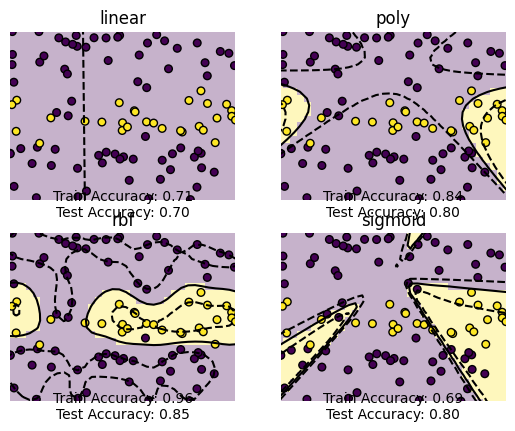

In [20]:
# Visual kernel comparison for selected flags
'''ADD SOME CODE HERE'''
for i in range(4):
    X, y = sample_pixels(images[i], num_samples=100)
    kernel_comparison(X, y, support_vectors=False, tight_box=True, if_flag=True, degree=3, gamma=100)
    plt.show()

In [25]:
# Non-visual kernel comparison for all flags
import pandas as pd

results = pd.DataFrame()
image_list = []
columns=['Image Label', 'Num Samples', 'Kernel', 'Train Accuracy', 'Test Accuracy']
num_samples_list = []
kernels = []
train_accuracies = []
test_accuracies = []
for num_samples in [200, 400, 600, 800, 1000]:
    for i in range(len(images)):
        X, y = sample_pixels(images[i], num_samples=num_samples)
        result = kernel_comparison(X, y, support_vectors=False, tight_box=True, if_flag=False, degree=3, gamma=3, quant=True)
        for kernel in result:
            image_list.append(labels[i])
            num_samples_list.append(num_samples)
            kernels.append(kernel)
            train_accuracies.append(result[kernel][0])
            test_accuracies.append(result[kernel][1])

results["Image Label"] = image_list
results["Num Samples"] = num_samples_list
results["Kernel"] = kernels
results["Train Accuracy"] = train_accuracies
results["Test Accuracy"] = test_accuracies
results.head()


,Image Label,Num Samples,Kernel,Train Accuracy,Test Accuracy
0,ut,200,linear,0.8625,0.90
1,ut,200,poly,0.8625,0.90
2,ut,200,rbf,0.8625,0.90
3,ut,200,sigmoid,0.8625,0.90
4,me,200,linear,0.9375,0.95


<Axes: xlabel='Image Label,Num Samples'>

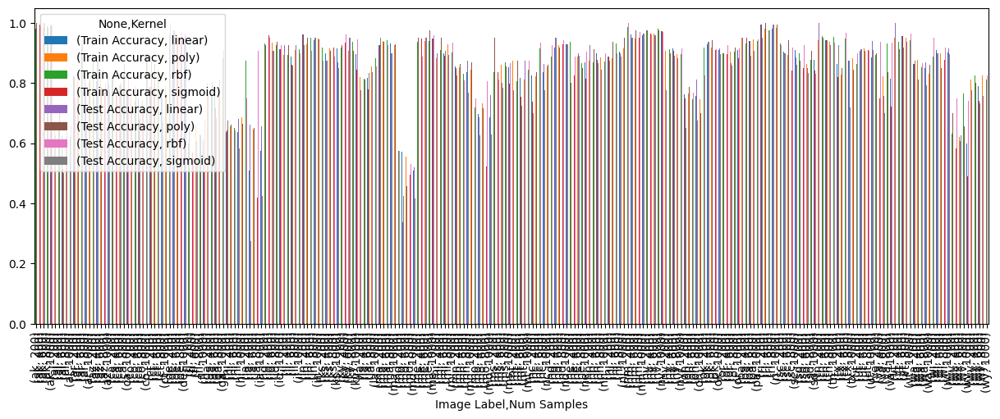

In [32]:
results.groupby(['Image Label', 'Num Samples', 'Kernel']).mean().unstack().plot(kind='bar', figsize=(15, 5))

In [33]:
two_hundred = results[results['Num Samples'] == 200]
two_hundred.describe()

,Num Samples,Train Accuracy,Test Accuracy
count,200.0,200.000000,200.000000
mean,200.0,0.854219,0.845375
std,0.0,0.108651,0.117557
min,200.0,0.531250,0.450000
25%,200.0,0.812500,0.750000
50%,200.0,0.887500,0.875000
75%,200.0,0.931250,0.925000
max,200.0,0.993750,1.000000


In [34]:
four_hundred = results[results['Num Samples'] == 400]
four_hundred.describe()

,Num Samples,Train Accuracy,Test Accuracy
count,200.0,200.000000,200.000000
mean,400.0,0.843266,0.851500
std,0.0,0.115559,0.126434
min,400.0,0.387500,0.275000
25%,400.0,0.790625,0.800000
50%,400.0,0.879687,0.893750
75%,400.0,0.928906,0.940625
max,400.0,0.993750,1.000000


In [35]:
six_hundred = results[results['Num Samples'] == 600]
six_hundred.describe()

,Num Samples,Train Accuracy,Test Accuracy
count,200.0,200.000000,200.000000
mean,600.0,0.845948,0.837750
std,0.0,0.114964,0.121605
min,600.0,0.335417,0.341667
25%,600.0,0.791146,0.783333
50%,600.0,0.887500,0.870833
75%,600.0,0.931771,0.916667
max,600.0,0.985417,1.000000


In [36]:
eight_hundred = results[results['Num Samples'] == 800]
eight_hundred.describe()

,Num Samples,Train Accuracy,Test Accuracy
count,200.0,200.000000,200.000000
mean,800.0,0.844133,0.847031
std,0.0,0.121075,0.119542
min,800.0,0.418750,0.412500
25%,800.0,0.796484,0.800000
50%,800.0,0.881250,0.887500
75%,800.0,0.928125,0.925000
max,800.0,0.989062,0.993750


In [37]:
one_thousand = results[results['Num Samples'] == 1000]
one_thousand.describe()

,Num Samples,Train Accuracy,Test Accuracy
count,200.0,200.000000,200.000000
mean,1000.0,0.838438,0.849225
std,0.0,0.124378,0.119614
min,1000.0,0.370000,0.415000
25%,1000.0,0.789062,0.798750
50%,1000.0,0.883750,0.895000
75%,1000.0,0.920000,0.935000
max,1000.0,0.992500,0.995000


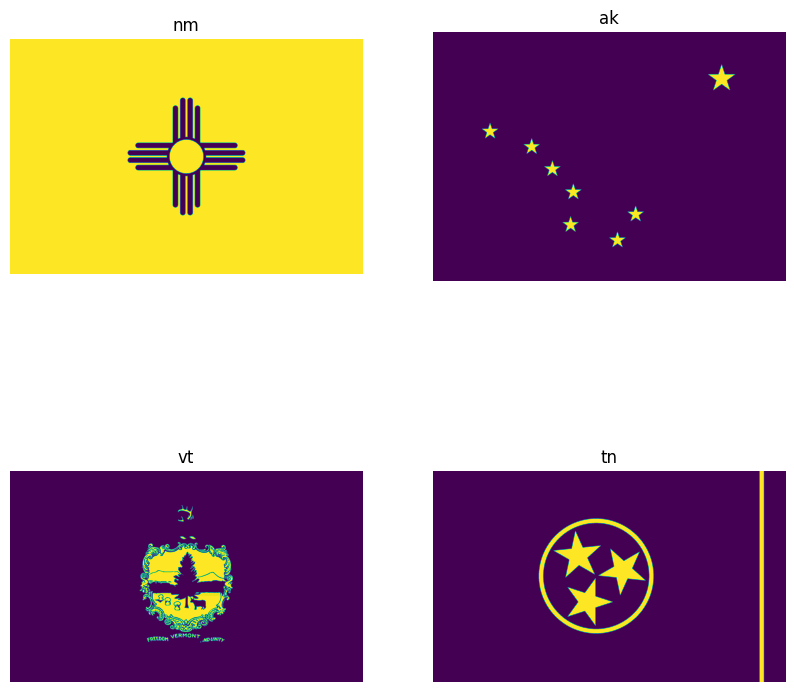

In [38]:
# For a given num samples and kernel, order images by highest test accuracy and then plot with function
def plot_images(num_samples, kernel, results, bottom=False):
    results_subset = results[(results['Num Samples'] == num_samples) & (results['Kernel'] == kernel)]
    results_subset = results_subset.sort_values(by='Test Accuracy', ascending=bottom)
    image_list = results_subset['Image Label'].tolist()
    images_subset = [images[labels.index(image)] for image in image_list]
    fig, axs = plt.subplots(
        2, 
        2, 
        figsize=(10, 10),
    )
    for i, ax in enumerate(axs.flat):
        ax.imshow(images_subset[i], cmap='viridis', aspect='equal')
        ax.axis('off')
        ax.set_title(image_list[i])
    plt.show()

# Plot images for 200 samples and linear kernel
plot_images(200, 'linear', results)

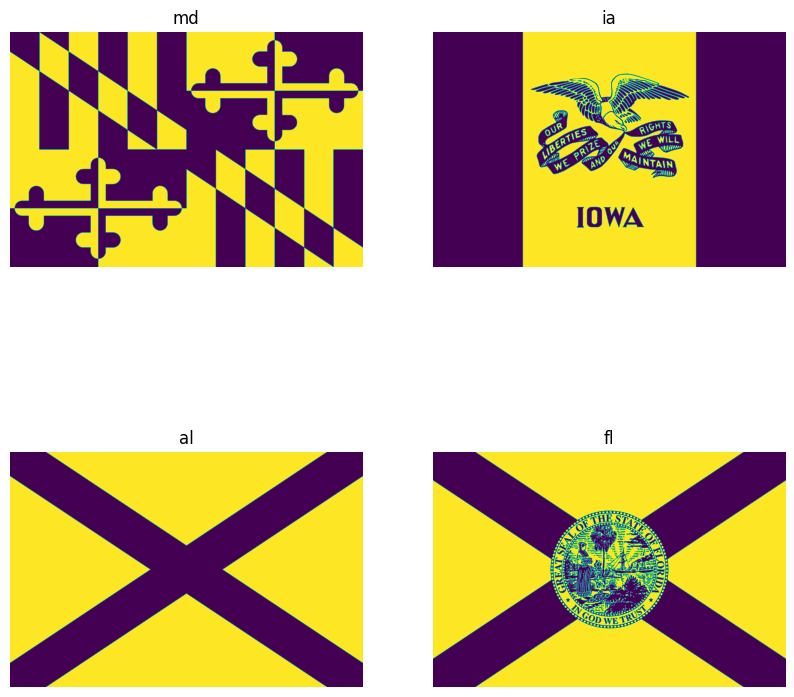

In [39]:
# Plot images for 200 samples and linear kernel
plot_images(200, 'linear', results, bottom=True)

For these experiments, I set `num_samples` to 200 because the results of the experiments seem to be the most stable for this number of sampled pixels.

The linear kernel performed best (i.e., highest test accuracy) on the flags of the following three states: 

1. Nm
2. Ak
3. Vt

It performed worst on the flags of the following three states: 

1. Md
2. Ia
3. Al

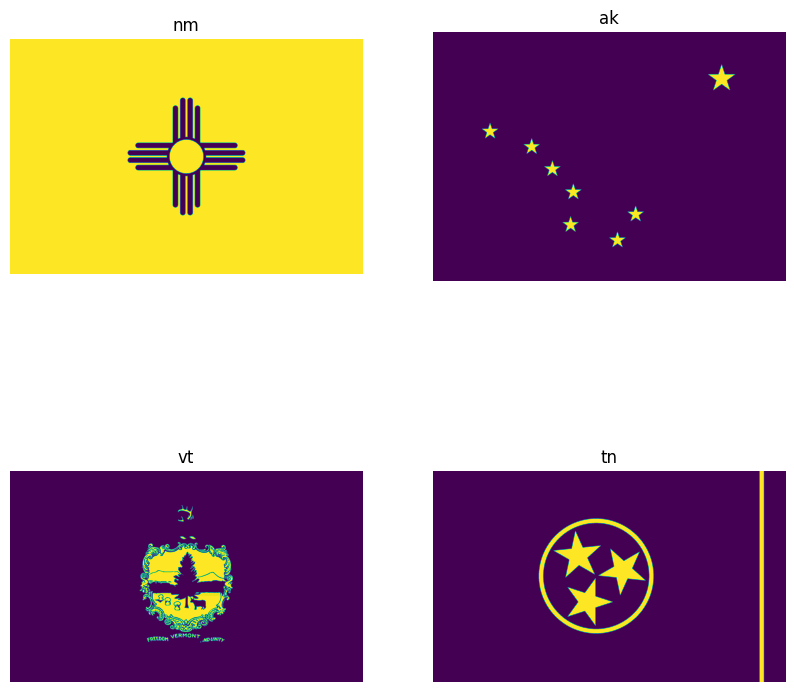

In [40]:
# Plot images for 200 samples and poly kernel
plot_images(200, 'poly', results)

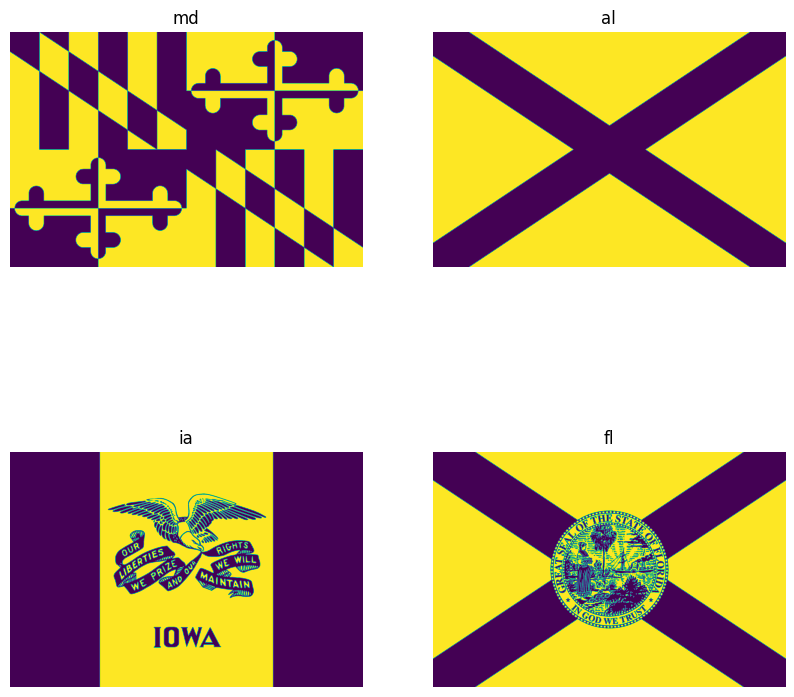

In [41]:
# Plot bottom for 200 samples and poly kernel
plot_images(200, 'poly', results, bottom=True)

The polynomial kernel performed best on the flags of the following three states: 

1. Nm
2. Ak
3. Vt

It performed worst on the flags of the following three states: 

1. Md
2. Al
3. Ia

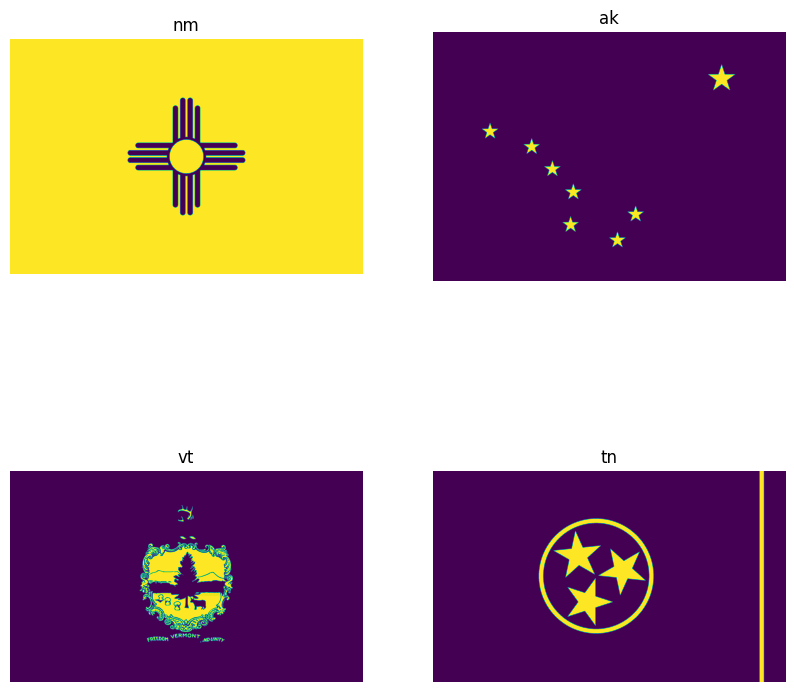

In [42]:
# Plot images for 200 samples and rbf kernel
plot_images(200, 'rbf', results)

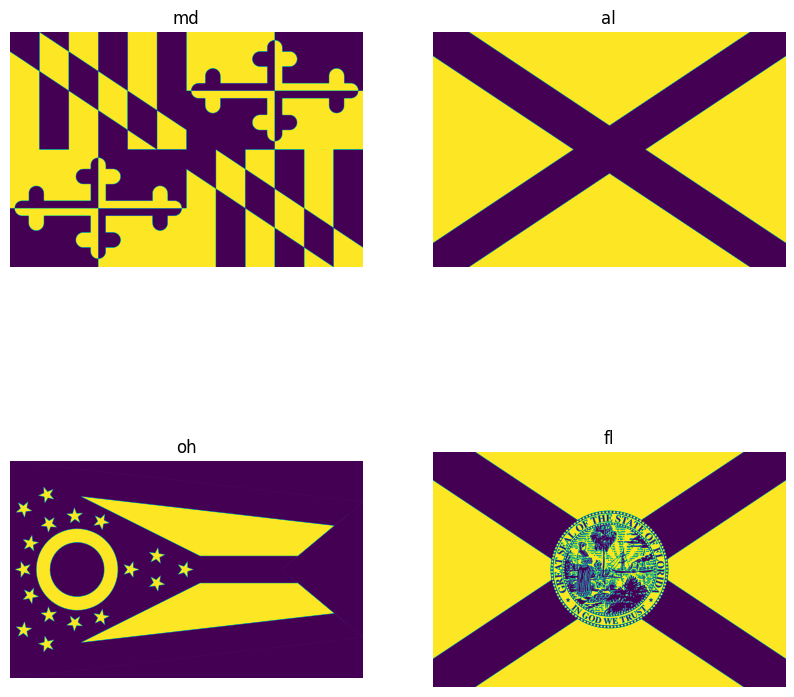

In [43]:
# Plot bottom for 200 samples and rbf kernel
plot_images(200, 'rbf', results, bottom=True)

The radial-basis function kernel performed best on the flags of the following three states: 

1. Nm
2. Ak
3. Vt

It performed worst on the flags of the following three states: 

1. Md
2. Al
3. Oh

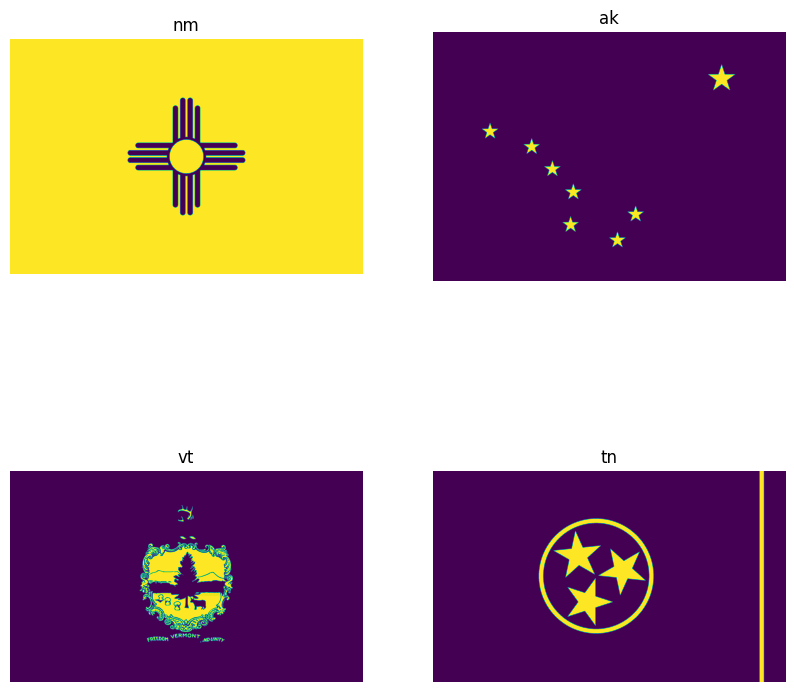

In [44]:
# Plot images for 200 samples and sigmoid kernel
plot_images(200, 'sigmoid', results)

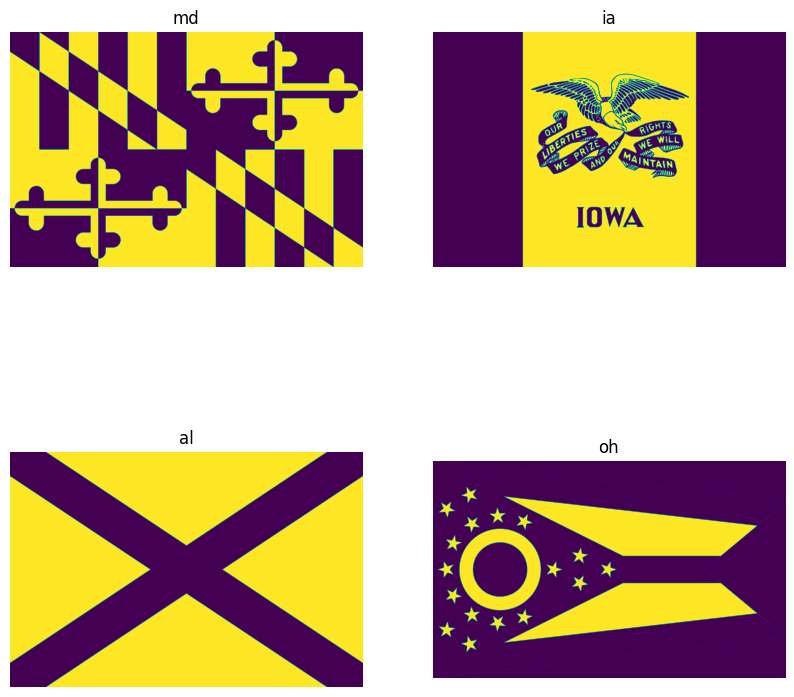

In [45]:
# Plot bottom for 200 samples and sigmoid kernel
plot_images(200, 'sigmoid', results, bottom=True)

The sigmoid kernel performed best on the flags of the following three states: 

1. Nm
2. Ak
3. Vt

It performed worst on the flags of the following three states:

1. Md
2. Ia
3. Al

### Part 2.3: Comparison to decision trees
Decision trees and SVMs yield substantially different decision boundaries.

1. An arbitrarily complex decision tree would be able to achieve perfect training accuracy on any data set. Explain why.
2. For a very large data set of flag pixels, an arbitrarily complex decision tree is likely to achieve (almost) perfect test accuracy as well. Explain why.
3. Select four flags for which you anticipate a *simple* decision tree to outperform all your SVMs. Write code that fits a decision tree to a flag pixel data set. Use your code to check your hypothesis. 

An arbitrarily complex decision tree would be able to achieve perfect training accuracy on any data set, because the decision tree could literally ask enough questions to determine exactly which datapoint it was referring to. This means that it could just pick what that datapoint was based on what it actually was in training.

For a very large data set of flag pixels, an arbitrarily complex decision tree is likely to achieve (almost) perfect test accuracy because it will just locate every single pixel and know precisely whether it is black or white, etc.

A simple decision tree is likely to perform well on the sampled pixel data of the flags of NM, AK, Vt. Also, any flag that has very clear grid-like chunks.

In [46]:
# Comparison of SVM and decision tree performance on sampled pixel data for four flags
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score

results_dt = pd.DataFrame()
image_list = []
columns=['Image Label', 'Num Samples', 'Model', 'Train Accuracy', 'Test Accuracy']
num_samples_list = []
models = []
train_accuracies = []
test_accuracies = []
for num_samples in [200, 400, 600, 800, 1000]:
    for i in range(len(images)):
        X, y = sample_pixels(images[i], num_samples=num_samples)
        # Train-test split at the top of the function, before the for loop
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)
        for model, model_name in zip([SVC(kernel='rbf', degree=3, gamma=3), DecisionTreeClassifier()], ['SVM', 'Decision Tree']):
            model.fit(X_train, y_train)
            train_accuracy = model.score(X_train, y_train)
            test_accuracy = model.score(X_test, y_test)
            image_list.append(labels[i])
            num_samples_list.append(num_samples)
            models.append(model_name)
            train_accuracies.append(train_accuracy)
            test_accuracies.append(test_accuracy)


results_dt["Image Label"] = image_list
results_dt["Num Samples"] = num_samples_list
results_dt["Model"] = models
results_dt["Train Accuracy"] = train_accuracies
results_dt["Test Accuracy"] = test_accuracies
results_dt.head()


,Image Label,Num Samples,Model,Train Accuracy,Test Accuracy
0,ut,200,SVM,0.94375,0.975
1,ut,200,Decision Tree,1.00000,0.900
2,me,200,SVM,0.95000,0.925
3,me,200,Decision Tree,1.00000,0.875
4,la,200,SVM,0.83125,0.800


In [49]:
# Compare SVM and decision tree performance for 200 samples
results_dt_subset = results_dt[results_dt['Num Samples'] == 200]
results_svm_subset = two_hundred

# Ones for specific comparison
specific_states = ['nm', 'ak', 'vt', 'wy']
for state in specific_states:
    print(f"State: {state}")
    print("SVM")
    print(results_svm_subset[results_svm_subset['Image Label'] == state])
    print("Decision Tree")
    print(results_dt_subset[results_dt_subset['Image Label'] == state])

State: nm
SVM
   Image Label  Num Samples   Kernel  Train Accuracy  Test Accuracy
64          nm          200   linear          0.9875            1.0
65          nm          200     poly          0.9875            1.0
66          nm          200      rbf          0.9875            1.0
67          nm          200  sigmoid          0.9875            1.0
Decision Tree
   Image Label  Num Samples          Model  Train Accuracy  Test Accuracy
32          nm          200            SVM         0.95625          0.975
33          nm          200  Decision Tree         1.00000          0.975
State: ak
SVM
    Image Label  Num Samples   Kernel  Train Accuracy  Test Accuracy
188          ak          200   linear         0.98125            1.0
189          ak          200     poly         0.98125            1.0
190          ak          200      rbf         0.98125            1.0
191          ak          200  sigmoid         0.98125            1.0
Decision Tree
   Image Label  Num Samples          